In [1]:
from experiments_frugality import *

/users/eleves-b/2021/jeremie.touati/.local/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
INFO:datasets:PyTorch version 2.5.1 available.


# FILTERS 5x5

In [2]:
std_noise_train = 0.05
std_noise = 0.05
components_list = [10, 50] #[2, 10, 50] #[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 20, 50, 100]
layers_list = [1, 20] #[1, 20]
n_rep_list = [1, 10, 50, 100, 1000] #[1, 20, 50, 100]
denoiser_type_list = ["SD"] #, "SD"]
pth_kernel = "blur_models/blur_3.mat" #"blur_models/blur_1.mat"
img_list = [0] #, 4]
n_iter_per_lambda = 200
n_lambda = 50
lambda_start = 10
lambda_end = 1e-5
eps_stop = 1e-6
warm_restart = True
save_path = "experiments/gloubiboulga/results.pkl"

params_model = {
        "kernel_size": 5,
        "lmbd": 1e-4,
        "color": COLOR,
        "device": DEVICE,
        "dtype": torch.float,
        "optimizer": "adam",
        "path_data": DATA_PATH,
        "max_sigma_noise": std_noise_train,
        "min_sigma_noise": std_noise_train,
        "mini_batch_size": 1,
        "max_batch": 10,
        "epochs": 50,
        "avg": False,
        "rescale": False,
        "fixed_noise": True,
        "D_shared": True,
        "step_size_scaling": 1.8,
        "lr": 1e-3,
        "dataset": DATASET,
    }

In [3]:
T_START = time.time()

DENOISERS = {"DRUNet": dict(model="drunet")}
DENOISERS["DRUNet"]["net"] = get_denoiser(**DENOISERS["DRUNet"])

for denoiser_type in denoiser_type_list:
    for components in components_list:
        for layers in layers_list:
            params = {k: v for k, v in params_model.items()}
            params["n_layers"] = layers
            params["n_components"] = components
            
            # ----- #REPEAT = #LAYERS -----
            if denoiser_type == "SD":
                base_name = f"SD_{components}C_{layers}L"
                model_type = "synthesis"
            elif denoiser_type == "AD":
                base_name = f"AD_{components}C_{layers}L"
                model_type = "analysis"
            
            name = f"{base_name}_{layers}R"
            DENOISERS[name] = {"model": model_type, **params}
            print(f"Training {base_name}...")
            DENOISERS[name]["net"] = get_denoiser(**DENOISERS[name])
            
            # ----- #REPEAT = 1 -----
            if layers > 1:
                denoiser = DENOISERS[name]
                old_net = denoiser["net"]
                net = UnrolledCDL(
                    type_unrolling=denoiser["model"],
                    **{k: v for k, v in denoiser.items() if k not in ["model", "net"]}
                ).unrolled_net
                # Replace the model with only the first layer of the trained model
                net.parameter = old_net.parameter
                net.model = torch.nn.ModuleList([old_net.model[0]])
                DENOISERS[f"{base_name}_1R"] = dict(net=net, model=denoiser["model"], **params)
                DENOISERS[f"{base_name}_1R"]["n_layers"] = 1
            
            # ----- #REPEAT = N_REP -----
            for n_rep in n_rep_list:
                if n_rep == layers:
                    continue
                denoiser = DENOISERS[f"{base_name}_1R"]
                old_net = denoiser["net"]
                net = UnrolledCDL(
                    type_unrolling=denoiser["model"],
                    **{k: v for k, v in denoiser.items() if k not in ["model", "net"]}
                ).unrolled_net
                assert len(net.model) == 1
                net.parameter = old_net.parameter
                net.model = torch.nn.ModuleList([old_net.model[0]] * n_rep)
                DENOISERS[f"{base_name}_{n_rep}R"] = dict(
                    net=net, model=denoiser["model"], **params
                )
                DENOISERS[f"{base_name}_{n_rep}R"]["n_layers"] = n_rep

print(f"\nSuccessfully prepared {len(DENOISERS.keys())} denoisers in {time.time() - T_START:.2f} seconds.")

Training SD_10C_1L...


Epoch 50 - Average train loss: 0.06480838 - Average test loss: 0.06009800: 100%|██████████| 50/50 [00:02<00:00, 18.87it/s]


Done
Training SD_10C_20L...


Epoch 50 - Average train loss: 0.00269176 - Average test loss: 0.00261558: 100%|██████████| 50/50 [00:08<00:00,  5.85it/s]


Done
Training SD_50C_1L...


Epoch 50 - Average train loss: 0.06321905 - Average test loss: 0.05791021: 100%|██████████| 50/50 [00:02<00:00, 17.38it/s]


Done
Training SD_50C_20L...


Epoch 50 - Average train loss: 0.00167074 - Average test loss: 0.00162557: 100%|██████████| 50/50 [00:15<00:00,  3.32it/s]

Done

Successfully prepared 23 denoisers in 29.70 seconds.


In [4]:
dataloader = create_dataloader(
    DATA_PATH,
    min_sigma_noise=std_noise,
    max_sigma_noise=std_noise,
    device=DEVICE,
    dtype=torch.float,
    mini_batch_size=1,
    train=False,
    color=COLOR,
    fixed_noise=True,
    crop=False,
)

In [5]:
img = dataloader.dataset[img_list[0]][1].cpu().numpy()
x_truth = img

In [6]:
h = scipy.io.loadmat(pth_kernel)
h = np.array(h["blur"])

Phi, Phit = get_operators(type_op="deconvolution", pth_kernel=pth_kernel)
x_blurred = Phi_channels(img, Phi)
nc, nxb, nyb = x_blurred.shape
x_observed = x_blurred + std_noise * np.random.randn(nc, nxb, nyb)
normPhi2 = op_norm2(Phi, Phit, x_observed.shape)
gamma = 1.0 / normPhi2

In [7]:
results = {
    "observation": x_observed,
    "truth": img
}

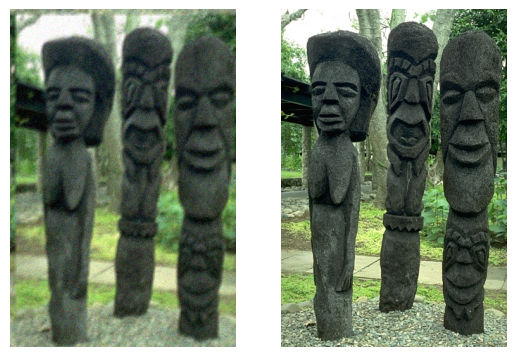

PSNR: 14.38 dB


/tmp/ipykernel_1362738/2873729282.py:14: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  print(f"PSNR: {peak_signal_noise_ratio(x_truth, x_observed.clip(0, 1)):.2f} dB")


In [8]:
def show_imgs(list_img, figsize=None, two_d=False):
    plt.figure(figsize=figsize)
    for i, img in enumerate(list_img):
        plt.subplot(1, len(list_img), i + 1)
        if two_d:
            img = img.squeeze()
        else:
            img = img.transpose(1, 2, 0)
        plt.imshow(img)
        plt.axis("off")
    plt.show()

show_imgs([x_observed.clip(0,1), x_truth])
print(f"PSNR: {peak_signal_noise_ratio(x_truth, x_observed.clip(0, 1)):.2f} dB")

## Display images

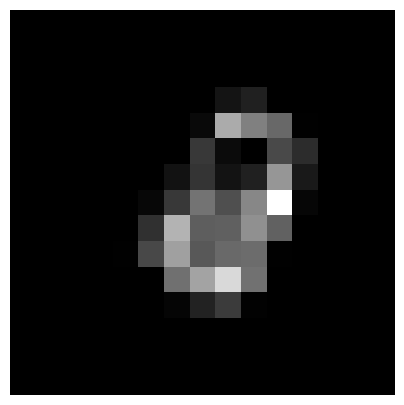

In [37]:
# Show the kernel
plt.figure(figsize=(5, 5))
plt.imshow(h, cmap="gray")
plt.axis("off")
plt.savefig("images/kernel.png", bbox_inches="tight", pad_inches=0)

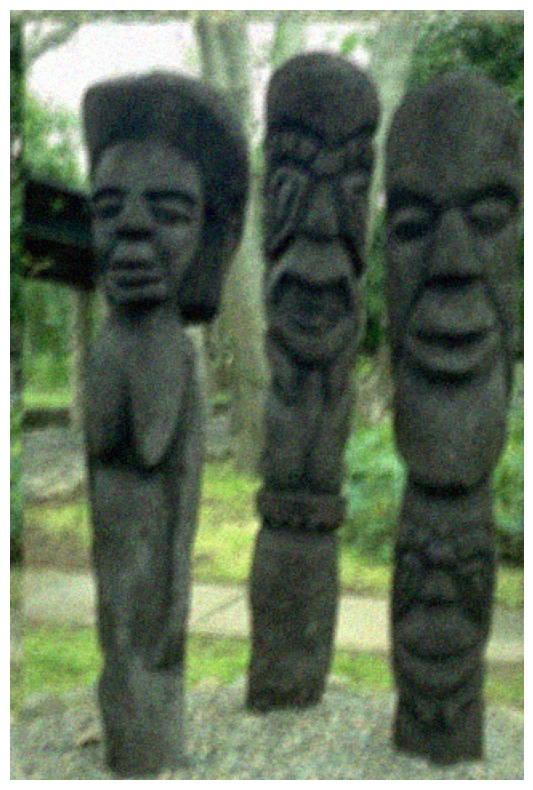

In [38]:
# Show truth and save in "images/truth.png"
plt.figure(figsize=(10, 10))
plt.imshow(x_observed.clip(0, 1).transpose(1, 2, 0))
plt.axis("off")
plt.savefig("images/observed.png", bbox_inches="tight", pad_inches=0)

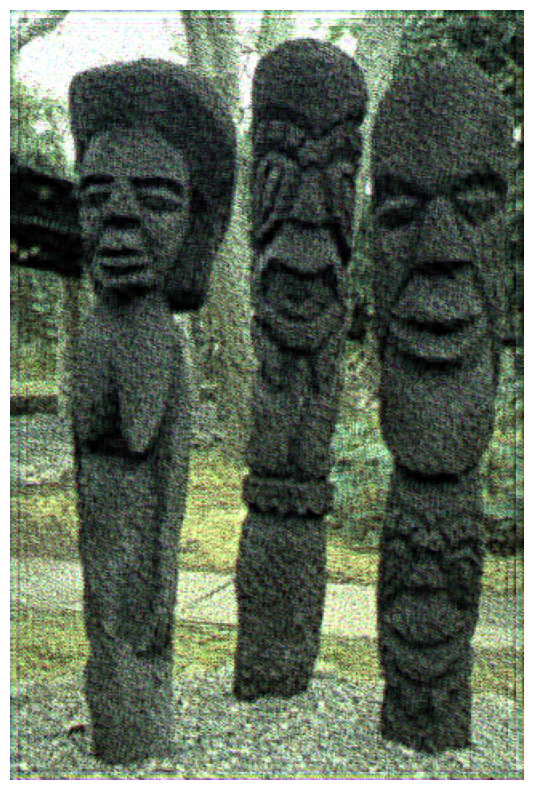

In [45]:
name_path = "SD_10C_1L"

path_results = "convergence/"+name_path+"/results_optimal_lambda.pkl"

with open(path_results, "rb") as f:
    list_results = pickle.load(f)
    img_denoised = list_results["best_x_psnr"]
    best_psnr = list_results["best_psnr"]
    current_dual = list_results["best_current_dual"]

# Show truth and save in "images/truth.png"
plt.figure(figsize=(10, 10))
plt.imshow(img_denoised.clip(0, 1).transpose(1, 2, 0))
plt.axis("off")
plt.savefig("images/"+name_path+".png", bbox_inches="tight", pad_inches=0)

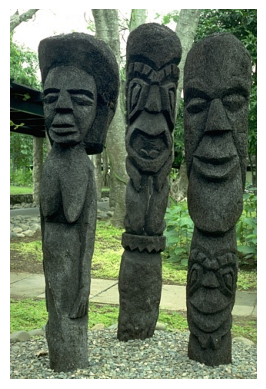

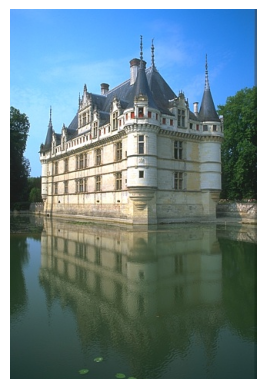

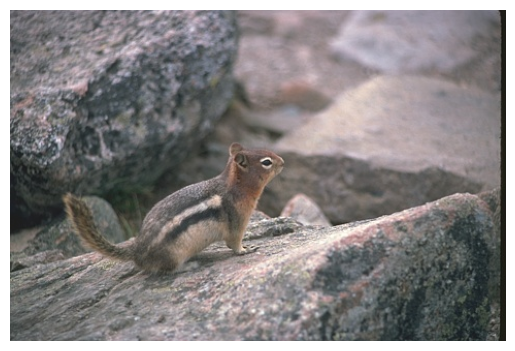

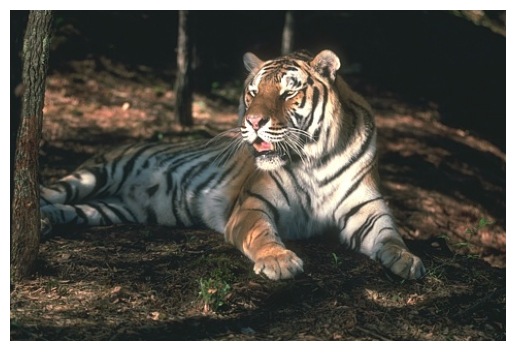

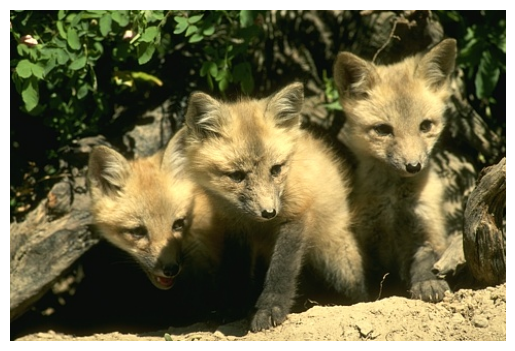

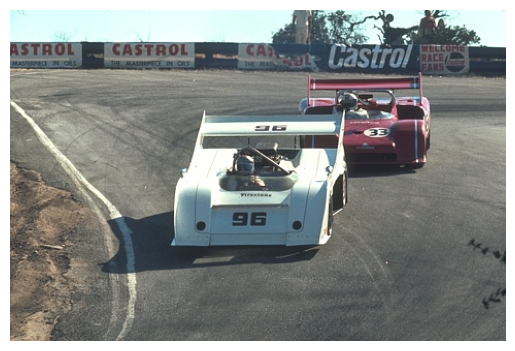

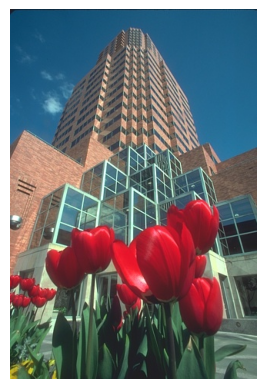

In [40]:
for i in [0,2,12,8,24,40,94]:
    show_imgs([dataloader.dataset[i][1].cpu().numpy()])

## Unbiasing: from $l_1$ to $l_2$

In [17]:
denoiser_names = ["SD_50C_1L_50R"]


Running denoiser: SD_50C_1L_50R


  0%|          | 0/100 [00:00<?, ?it/s]

100%|██████████| 100/100 [00:20<00:00,  4.94it/s]


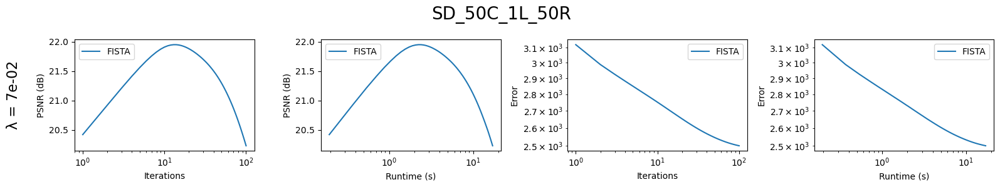

In [18]:
for denoiser_name in denoiser_names:
    
    print(f"\nRunning denoiser: {denoiser_name}")

    denoiser = DENOISERS[denoiser_name]
    net = denoiser["net"]
    model = "unrolled"
    
    lambdas = [6.62e-2]#[1e-3, 1e-2, 1e-1] #[4.96e-2] #[1e-8] #[1e-2] #[1e-1] #[1e-2]#, 1e-3, 1e-4]
    n = len(lambdas)
    plt.figure(figsize=(16, 3*n))
    i = 0
    
    for best_lambda in lambdas:
        
        x_n = Phi_channels(x_observed, Phit)
        current_dual = None
        current_dual_fast = None

        iter_final = 100
        error_final = [0] * iter_final
        psnr_final = [0] * iter_final
        best_psnr = 0
        runtime_final = [0] * iter_final
        cvg_final = [0] * iter_final
        t_iter = 0
        update_dual = True

        for t in tqdm(range(iter_final)):
            
            t_start = time.perf_counter()

            g_n = Phi_channels((Phi_channels(x_n, Phi) - x_observed), Phit)
            tmp = x_n - gamma * g_n
            
            
            x_old = x_n.copy()
            alpha = t/(t+4)
            #alpha = 0
            x_n, current_dual, current_dual_fast = apply_model(
                model, tmp, current_dual, best_lambda, net, update_dual,
                fast=True, dual_fast=current_dual_fast, alpha_fast=alpha
            )

            t_iter += time.perf_counter() - t_start
            runtime_final[t] = t_iter
            cvg_final[t] = np.sum((x_n - x_old) ** 2)
            psnr_final[t] = peak_signal_noise_ratio(x_n, x_truth)
            error_final[t] = error_synthesis(current_dual[0], x_observed, net, Phi, best_lambda)
            
            if psnr_final[t] > best_psnr:
                best_x = x_n.copy()
                best_dual = current_dual.copy()
                best_psnr = psnr_final[t]
                
                
        plt.subplot(n, 4, 4*i+1)
        
        plt.text(-0.3, 0.5, f"λ = {best_lambda:.0e}", fontsize=16,
                 transform=plt.gca().transAxes, rotation=90,
                 verticalalignment='center', horizontalalignment='right')
        
        plt.semilogx(np.arange(1, iter_final + 1), psnr_final, label="FISTA")
        plt.xlabel("Iterations")
        plt.ylabel("PSNR (dB)")
        plt.legend()

        plt.subplot(n, 4, 4*i+2)
        plt.semilogx(runtime_final, psnr_final, label="FISTA")
        plt.xlabel("Runtime (s)")
        plt.ylabel("PSNR (dB)")
        plt.legend()

        plt.subplot(n, 4, 4*i+3)
        plt.loglog(np.arange(1, iter_final + 1), error_final, label="FISTA")
        plt.xlabel("Iterations")
        plt.ylabel("Error")
        plt.legend()

        plt.subplot(n, 4, 4*i+4)
        plt.loglog(runtime_final, error_final, label="FISTA")
        plt.xlabel("Runtime (s)")
        plt.ylabel("Error")
        plt.legend()
        
        i += 1

    plt.suptitle(f"{denoiser_name}", fontsize=20)
    plt.tight_layout()
    plt.show()

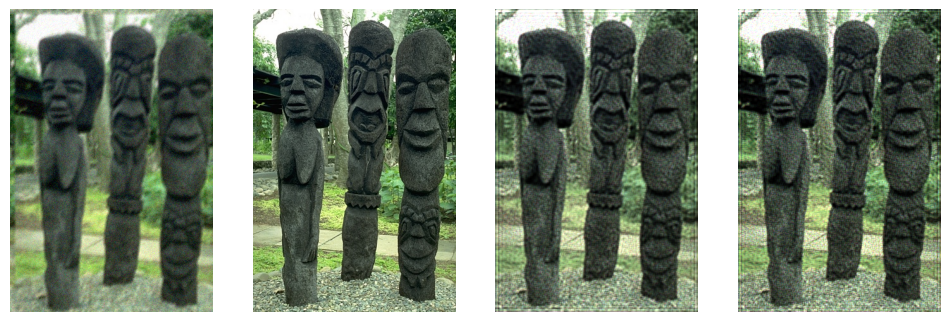

In [12]:
show_imgs([x_observed, x_truth, best_x, x_n], figsize=(12, 4))

### REPORT IMAGES

In [53]:
support_z = current_dual != 0
support_z = torch.tensor(support_z, dtype=torch.float, device=DEVICE)
print(f"Proportion of zero elements in the dual: {np.mean(current_dual[0] == 0):.2%}")

Proportion of zero elements in the dual: 98.64%


  0%|          | 0/500 [00:00<?, ?it/s]

100%|██████████| 500/500 [00:23<00:00, 21.67it/s]


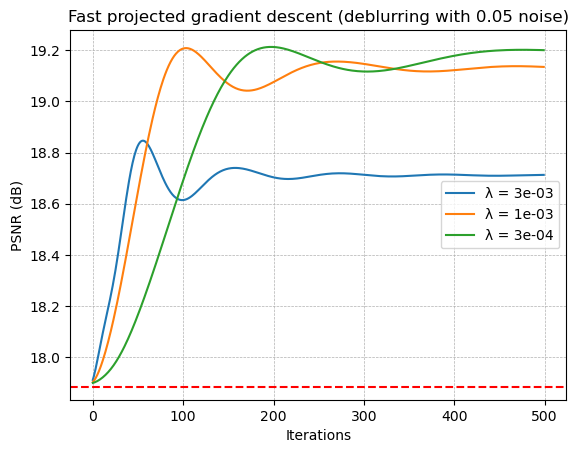

In [48]:
parameter = net.parameter

iter_grad = 500
step_size = gamma*1/net.compute_lipschitz()

plt.figure()
for lamb in [3e-3, 1e-3, 3e-4]: #[1e-5, 3e-5, 1e-4, 3e-4, 1e-3, 3e-3, 1e-2, 3e-2, 1e-1]:

    z_n_proj_fast = current_dual.copy()
    z_n_proj_fast = torch.tensor(z_n_proj_fast, device=DEVICE, dtype=torch.float)
    w_n = z_n_proj_fast.clone()
    psnr_unbiased_proj_fast = []
    error_unbiased_proj_fast = []
    for i in tqdm(range(iter_grad)):
        old_z_n = z_n_proj_fast.clone()
        grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
        grad = Phi_channels(grad, Phi) - x_observed
        error_unbiased_proj_fast.append(np.linalg.norm(grad))
        grad = Phi_channels(grad, Phit)
        grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
        grad = net.conv(grad, net.parameter)
        w_n -= step_size * grad
        z_n_proj_fast = w_n * support_z * (1/(1+lamb))
        x_unbiased_proj_fast = net.convt(z_n_proj_fast, net.parameter).detach().cpu().numpy()[0]
        alpha_i = i / (i + 4)
        w_n = z_n_proj_fast + alpha_i * (z_n_proj_fast - old_z_n)
        psnr_unbiased_proj_fast.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj_fast))
    
    plt.plot(psnr_unbiased_proj_fast, label=f"λ = {lamb:.0e}")
    
plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()
plt.title(f"Fast projected gradient descent (deblurring with {std_noise:.2f} noise)")
plt.axhline(psnr_final[-1], color='red', linestyle='--', label="SD")
plt.show()

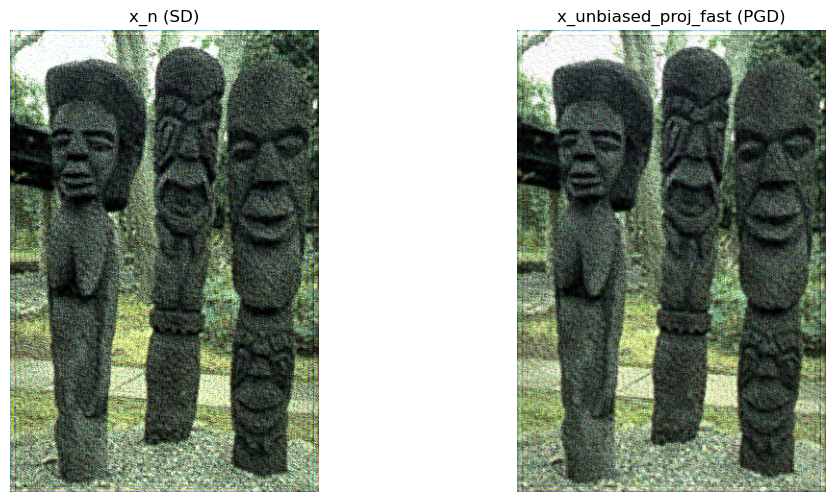

In [50]:
# Show x_n and x_unbiased_proj_fast side by side
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.imshow(x_n.clip(0, 1).transpose(1, 2, 0))
plt.axis("off")
plt.title("x_n (SD)")
plt.subplot(1, 2, 2)
plt.imshow(x_unbiased_proj_fast.clip(0, 1).transpose(1, 2, 0))
plt.axis("off")
plt.title("x_unbiased_proj_fast (PGD)")
plt.show()

### ALL UNBIAISING IN ONE PLOT

In [19]:
support_z = current_dual != 0
support_z = torch.tensor(support_z, dtype=torch.float, device=DEVICE)
print(f"Proportion of zero elements in the dual: {np.mean(current_dual[0] == 0):.2%}")

parameter = net.parameter
iter_grad = 500
step_size = gamma*1/net.compute_lipschitz()
step_size_x = gamma

lamb = 1e-3
lamb_x = 1e-1

# GRADIENT DESCENT ON x
# x_n_fast = x_n.copy()
x_n_fast = np.zeros_like(x_n)
w_n = x_n_fast.copy()
psnr_unbiased_fast_x = []
error_unbiased_fast_x = []
for i in tqdm(range(iter_grad)):
    old_x_n = x_n_fast.copy()
    grad = Phi_channels(w_n, Phi) - x_observed
    error_unbiased_fast_x.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    w_n -= step_size_x * grad
    x_n_fast = w_n * (1/(1+lamb_x))
    alpha_i = i / (i + 4)
    w_n = x_n_fast + alpha_i * (x_n_fast - old_x_n)
    psnr_unbiased_fast_x.append(peak_signal_noise_ratio(x_truth, x_n_fast))

# GRADIENT DESCENT ON z
#z_n_fast = current_dual.copy()
z_n_fast = np.zeros_like(current_dual)
z_n_fast = torch.tensor(z_n_fast, device=DEVICE, dtype=torch.float)
w_n = z_n_fast.clone()
psnr_unbiased_fast = []
error_unbiased_fast = []
for i in tqdm(range(iter_grad)):
    old_z_n = z_n_fast.clone()
    grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased_fast.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    w_n -= step_size * grad
    z_n_fast = w_n * (1/(1+lamb))
    x_unbiased_fast = net.convt(z_n_fast, net.parameter).detach().cpu().numpy()[0]
    alpha_i = i / (i + 4)
    w_n = z_n_fast + alpha_i * (z_n_fast - old_z_n)
    psnr_unbiased_fast.append(peak_signal_noise_ratio(x_truth, x_unbiased_fast))

# PROJECTED GRADIENT DESCENT ON z
#z_n_proj_fast = current_dual.copy()
z_n_proj_fast = np.zeros_like(current_dual)
z_n_proj_fast = torch.tensor(z_n_proj_fast, device=DEVICE, dtype=torch.float)
w_n = z_n_proj_fast.clone()
psnr_unbiased_proj_fast = []
error_unbiased_proj_fast = []
for i in tqdm(range(iter_grad)):
    old_z_n = z_n_proj_fast.clone()
    grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased_proj_fast.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    w_n -= step_size * grad
    z_n_proj_fast = w_n * support_z * (1/(1+lamb))
    x_unbiased_proj_fast = net.convt(z_n_proj_fast, net.parameter).detach().cpu().numpy()[0]
    alpha_i = i / (i + 4)
    w_n = z_n_proj_fast + alpha_i * (z_n_proj_fast - old_z_n)
    psnr_unbiased_proj_fast.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj_fast))

Proportion of zero elements in the dual: 97.00%


100%|██████████| 500/500 [00:24<00:00, 20.32it/s]


In [20]:
# Save the results
results = {
    "psnr_unbiased_fast_x": psnr_unbiased_fast_x,
    "psnr_unbiased_fast": psnr_unbiased_fast,
    "psnr_unbiased_proj_fast": psnr_unbiased_proj_fast,
    "x_n_fast": x_n_fast,
    "x_unbiased_fast": x_unbiased_fast,
    "x_unbiased_proj_fast": x_unbiased_proj_fast,
}
with open("images_deblurring/unbiasing_SD_5K_50C_1L.pkl", "wb") as f:
    pickle.dump(results, f)

### SD_5K_10C_1L

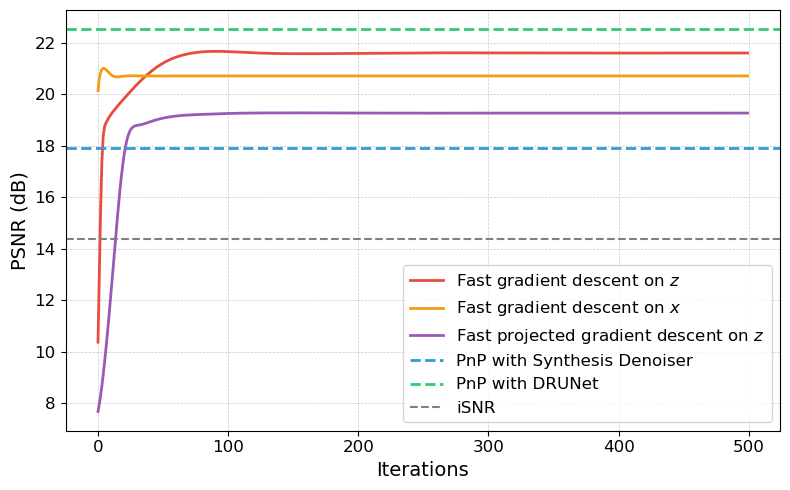

In [16]:
# Load results from the saved file
with open("images_deblurring/unbiasing_SD_5K_10C_1L.pkl", "rb") as f:
    results = pickle.load(f)
psnr_unbiased_fast_x = results["psnr_unbiased_fast_x"]
psnr_unbiased_fast = results["psnr_unbiased_fast"]
psnr_unbiased_proj_fast = results["psnr_unbiased_proj_fast"]

plt.figure(figsize=(8, 5))

# Sexy and modern color mapping
colors = {
    "drunet": "#2ecc71",     # Green
    "synthesis": "#3498db",  # Blue
    "proj_z": "#9b59b6",     # Purple
    "gd_x": "#f39c12",       # Orange
    "gd_z": "#e74c3c",       # Red
}

plt.plot(psnr_unbiased_fast, label=rf"Fast gradient descent on $z$", color=colors["gd_z"], linewidth=2)
plt.plot(psnr_unbiased_fast_x, label=rf"Fast gradient descent on $x$", color=colors["gd_x"], linewidth=2)
plt.plot(psnr_unbiased_proj_fast, label=rf"Fast projected gradient descent on $z$", color=colors["proj_z"], linewidth=2)

plt.axhline(17.9, linestyle='--', label="PnP with Synthesis Denoiser", color=colors["synthesis"], linewidth=2)
plt.axhline(22.52, linestyle='--', label="PnP with DRUNet", color=colors["drunet"], linewidth=2)
plt.axhline(14.38, linestyle='--', label="iSNR", color="grey")

plt.xlabel("Iterations", fontsize=14)
plt.ylabel("PSNR (dB)", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.7)
plt.legend(fontsize=12)
plt.tight_layout()
plt.savefig("images_deblurring/unbiasing_SD_5K_10C_1L.pdf", bbox_inches="tight")
plt.show()

### SD_5K_50C_1L

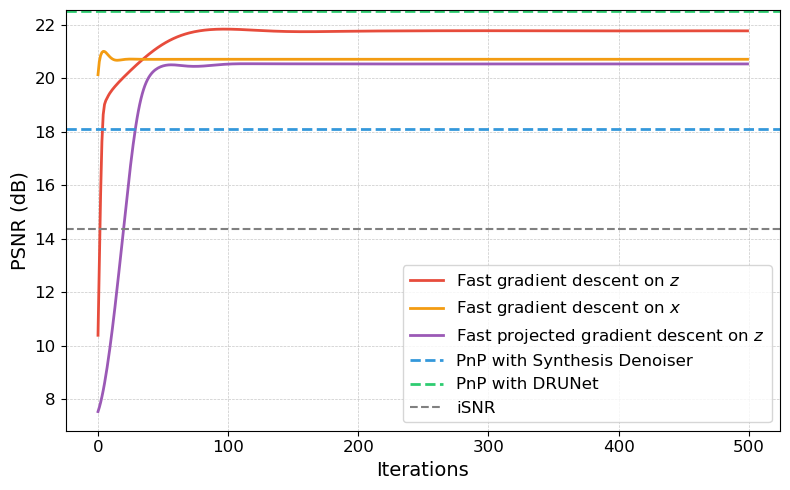

In [3]:
# Load results from the saved file
with open("images_deblurring/unbiasing_SD_5K_50C_1L.pkl", "rb") as f:
    results = pickle.load(f)
psnr_unbiased_fast_x = results["psnr_unbiased_fast_x"]
psnr_unbiased_fast = results["psnr_unbiased_fast"]
psnr_unbiased_proj_fast = results["psnr_unbiased_proj_fast"]

plt.figure(figsize=(8, 5))

# Sexy and modern color mapping
colors = {
    "drunet": "#2ecc71",     # Green
    "synthesis": "#3498db",  # Blue
    "proj_z": "#9b59b6",     # Purple
    "gd_x": "#f39c12",       # Orange
    "gd_z": "#e74c3c",       # Red
}

plt.plot(psnr_unbiased_fast, label=rf"Fast gradient descent on $z$", color=colors["gd_z"], linewidth=2)
plt.plot(psnr_unbiased_fast_x, label=rf"Fast gradient descent on $x$", color=colors["gd_x"], linewidth=2)
plt.plot(psnr_unbiased_proj_fast, label=rf"Fast projected gradient descent on $z$", color=colors["proj_z"], linewidth=2)

plt.axhline(18.09, linestyle='--', label="PnP with Synthesis Denoiser", color=colors["synthesis"], linewidth=2)
plt.axhline(22.52, linestyle='--', label="PnP with DRUNet", color=colors["drunet"], linewidth=2)
plt.axhline(14.38, linestyle='--', label="iSNR", color="grey")

plt.xlabel("Iterations", fontsize=14)
plt.ylabel("PSNR (dB)", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.7)
plt.legend(fontsize=12)
plt.tight_layout()
plt.savefig("images_deblurring/unbiasing_SD_5K_50C_1L.pdf", bbox_inches="tight")
plt.show()

### SD_16K_10C_1L

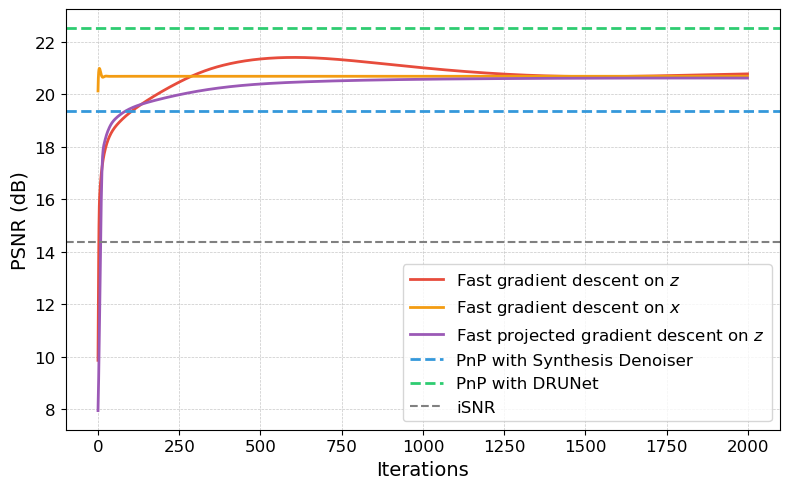

In [4]:
# Load results from the saved file
with open("images_deblurring/unbiasing_SD_16K_10C_1L.pkl", "rb") as f:
    results = pickle.load(f)
psnr_unbiased_fast_x = results["psnr_unbiased_fast_x"]
psnr_unbiased_fast = results["psnr_unbiased_fast"]
psnr_unbiased_proj_fast = results["psnr_unbiased_proj_fast"]

plt.figure(figsize=(8, 5))

# Sexy and modern color mapping
colors = {
    "drunet": "#2ecc71",     # Green
    "synthesis": "#3498db",  # Blue
    "proj_z": "#9b59b6",     # Purple
    "gd_x": "#f39c12",       # Orange
    "gd_z": "#e74c3c",       # Red
}

plt.plot(psnr_unbiased_fast, label=rf"Fast gradient descent on $z$", color=colors["gd_z"], linewidth=2)
plt.plot(psnr_unbiased_fast_x, label=rf"Fast gradient descent on $x$", color=colors["gd_x"], linewidth=2)
plt.plot(psnr_unbiased_proj_fast, label=rf"Fast projected gradient descent on $z$", color=colors["proj_z"], linewidth=2)

plt.axhline(19.37, linestyle='--', label="PnP with Synthesis Denoiser", color=colors["synthesis"], linewidth=2)
plt.axhline(22.52, linestyle='--', label="PnP with DRUNet", color=colors["drunet"], linewidth=2)
plt.axhline(14.38, linestyle='--', label="iSNR", color="grey")

plt.xlabel("Iterations", fontsize=14)
plt.ylabel("PSNR (dB)", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.7)
plt.legend(fontsize=12)
plt.tight_layout()
plt.savefig("images_deblurring/unbiasing_SD_16K_10C_1L.pdf", bbox_inches="tight")
plt.show()

### SD_16K_50C_1L

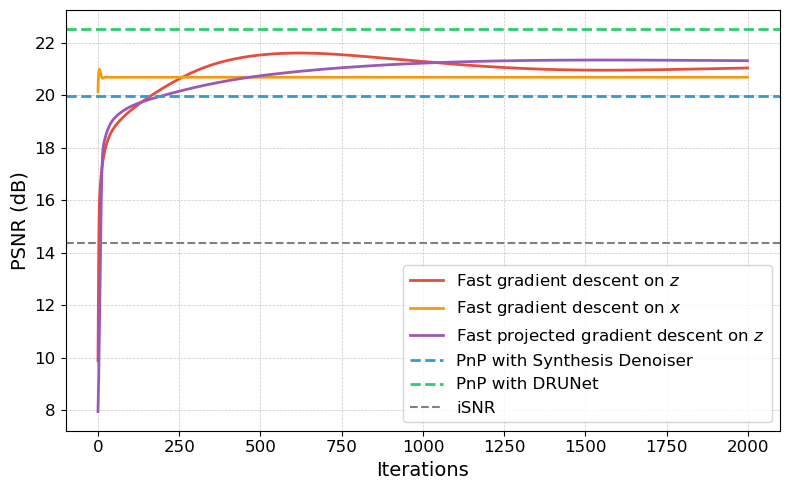

In [5]:
# Load results from the saved file
with open("images_deblurring/unbiasing_SD_16K_50C_1L.pkl", "rb") as f:
    results = pickle.load(f)
psnr_unbiased_fast_x = results["psnr_unbiased_fast_x"]
psnr_unbiased_fast = results["psnr_unbiased_fast"]
psnr_unbiased_proj_fast = results["psnr_unbiased_proj_fast"]

plt.figure(figsize=(8, 5))

# Sexy and modern color mapping
colors = {
    "drunet": "#2ecc71",     # Green
    "synthesis": "#3498db",  # Blue
    "proj_z": "#9b59b6",     # Purple
    "gd_x": "#f39c12",       # Orange
    "gd_z": "#e74c3c",       # Red
}

plt.plot(psnr_unbiased_fast, label=rf"Fast gradient descent on $z$", color=colors["gd_z"], linewidth=2)
plt.plot(psnr_unbiased_fast_x, label=rf"Fast gradient descent on $x$", color=colors["gd_x"], linewidth=2)
plt.plot(psnr_unbiased_proj_fast, label=rf"Fast projected gradient descent on $z$", color=colors["proj_z"], linewidth=2)

plt.axhline(19.97, linestyle='--', label="PnP with Synthesis Denoiser", color=colors["synthesis"], linewidth=2)
plt.axhline(22.52, linestyle='--', label="PnP with DRUNet", color=colors["drunet"], linewidth=2)
plt.axhline(14.38, linestyle='--', label="iSNR", color="grey")

plt.xlabel("Iterations", fontsize=14)
plt.ylabel("PSNR (dB)", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.7)
plt.legend(fontsize=12)
plt.tight_layout()
plt.savefig("images_deblurring/unbiasing_SD_16K_50C_1L.pdf", bbox_inches="tight")
plt.show()

### Kernel n°1 + noise 0.05 + best $\lambda$

In [66]:
support_z = current_dual != 0
support_z = torch.tensor(support_z, dtype=torch.float, device=DEVICE)
print(f"Proportion of zero elements in the dual: {np.mean(current_dual[0] == 0):.2%}")

Proportion of zero elements in the dual: 98.64%


  0%|          | 0/200 [00:00<?, ?it/s]

100%|██████████| 200/200 [00:10<00:00, 19.74it/s]


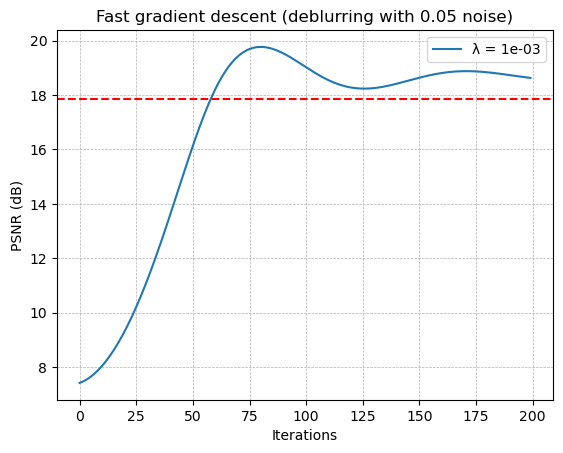

In [18]:
parameter = net.parameter

iter_grad = 200
step_size = gamma*1/net.compute_lipschitz()

plt.figure()
for lamb in [1e-3]:#[3e-5, 1e-4, 1e-3]: #e-3, 1e-3, 3e-4]: # [1e-5, 3e-5, 1e-4, 3e-4, 1e-3, 3e-3, 1e-2, 3e-2, 1e-1]:
    #x_n_fast = x_n.copy()
    # Initialize wit h zero
    x_n_fast = np.zeros_like(x_n_fast)
    w_n = x_n_fast.copy()
    psnr_unbiased_fast_x = []
    error_unbiased_fast_x = []
    for i in tqdm(range(iter_grad)):
        old_x_n = x_n_fast.copy()
        grad = Phi_channels(w_n, Phi) - x_observed
        error_unbiased_fast_x.append(np.linalg.norm(grad))
        grad = Phi_channels(grad, Phit)
        w_n -= step_size * grad
        x_n_fast = w_n * (1/(1+lamb))
        alpha_i = i / (i + 4)
        w_n = x_n_fast + alpha_i * (x_n_fast - old_x_n)
        psnr_unbiased_fast_x.append(peak_signal_noise_ratio(x_truth, x_n_fast))
    
    plt.plot(psnr_unbiased_fast_x, label=f"λ = {lamb:.0e}")

plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()
plt.title(f"Fast gradient descent (deblurring with {std_noise:.2f} noise)")
plt.axhline(psnr_final[-1], color='red', linestyle='--', label="SD")
plt.show()

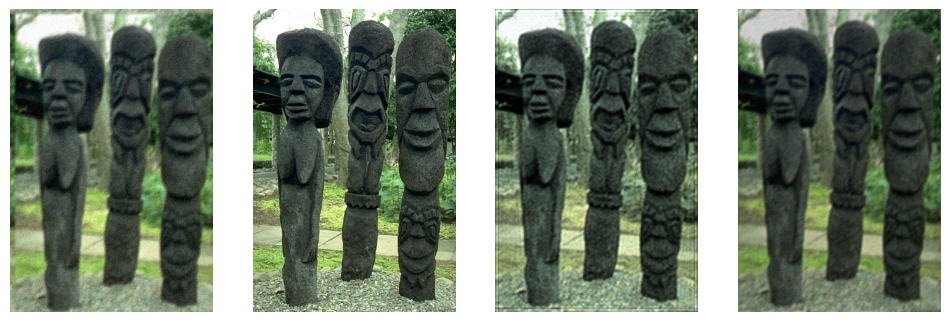

In [23]:
show_imgs([x_observed, x_truth, best_x, x_n_fast], figsize=(12, 4))

  0%|          | 0/500 [00:00<?, ?it/s]

100%|██████████| 500/500 [00:23<00:00, 21.50it/s]


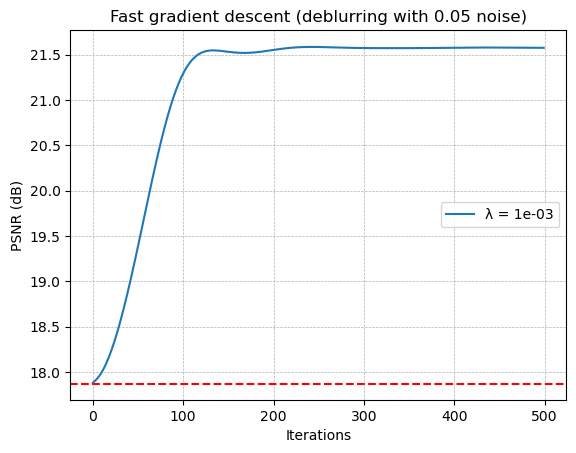

In [19]:
parameter = net.parameter

iter_grad = 500
step_size = gamma*1/net.compute_lipschitz()

plt.figure()
for lamb in [1e-3]:#[3e-3, 1e-3, 3e-4]: # [1e-5, 3e-5, 1e-4, 3e-4, 1e-3, 3e-3, 1e-2, 3e-2, 1e-1]:
    z_n_fast = current_dual.copy()
    z_n_fast = torch.tensor(z_n_fast, device=DEVICE, dtype=torch.float)
    w_n = z_n_fast.clone()
    psnr_unbiased_fast = []
    error_unbiased_fast = []
    for i in tqdm(range(iter_grad)):
        old_z_n = z_n_fast.clone()
        grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
        grad = Phi_channels(grad, Phi) - x_observed
        error_unbiased_fast.append(np.linalg.norm(grad))
        grad = Phi_channels(grad, Phit)
        grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
        grad = net.conv(grad, net.parameter)
        w_n -= step_size * grad
        z_n_fast = w_n * (1/(1+lamb))
        x_unbiased_fast = net.convt(z_n_fast, net.parameter).detach().cpu().numpy()[0]
        alpha_i = i / (i + 4)
        w_n = z_n_fast + alpha_i * (z_n_fast - old_z_n)
        psnr_unbiased_fast.append(peak_signal_noise_ratio(x_truth, x_unbiased_fast))
    
    plt.plot(psnr_unbiased_fast, label=f"λ = {lamb:.0e}")

plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()
plt.title(f"Fast gradient descent (deblurring with {std_noise:.2f} noise)")
plt.axhline(psnr_final[-1], color='red', linestyle='--', label="SD")
plt.show()

  0%|          | 0/200 [00:00<?, ?it/s]

100%|██████████| 200/200 [00:09<00:00, 21.75it/s]


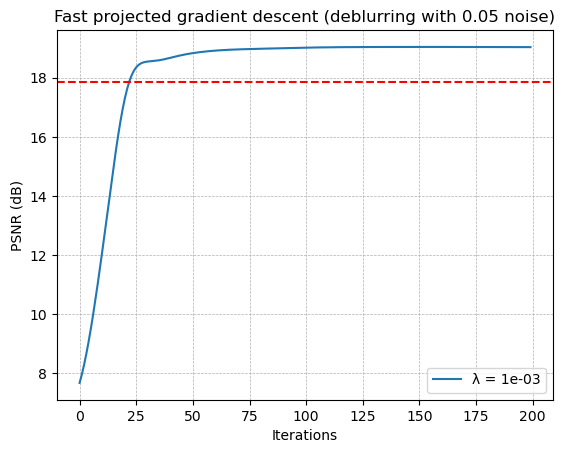

In [22]:
parameter = net.parameter

iter_grad = 200
step_size = gamma*1/net.compute_lipschitz()

plt.figure()
for lamb in [1e-3]:#[3e-3, 1e-3, 3e-4]: #[1e-5, 3e-5, 1e-4, 3e-4, 1e-3, 3e-3, 1e-2, 3e-2, 1e-1]:

    #z_n_proj_fast = current_dual.copy()
    z_n_proj_fast = np.zeros_like(current_dual)
    z_n_proj_fast = torch.tensor(z_n_proj_fast, device=DEVICE, dtype=torch.float)
    w_n = z_n_proj_fast.clone()
    psnr_unbiased_proj_fast = []
    error_unbiased_proj_fast = []
    for i in tqdm(range(iter_grad)):
        old_z_n = z_n_proj_fast.clone()
        grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
        grad = Phi_channels(grad, Phi) - x_observed
        error_unbiased_proj_fast.append(np.linalg.norm(grad))
        grad = Phi_channels(grad, Phit)
        grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
        grad = net.conv(grad, net.parameter)
        w_n -= step_size * grad
        z_n_proj_fast = w_n * support_z * (1/(1+lamb))
        x_unbiased_proj_fast = net.convt(z_n_proj_fast, net.parameter).detach().cpu().numpy()[0]
        alpha_i = i / (i + 4)
        w_n = z_n_proj_fast + alpha_i * (z_n_proj_fast - old_z_n)
        psnr_unbiased_proj_fast.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj_fast))
    
    plt.plot(psnr_unbiased_proj_fast, label=f"λ = {lamb:.0e}")
    
plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()
plt.title(f"Fast projected gradient descent (deblurring with {std_noise:.2f} noise)")
plt.axhline(psnr_final[-1], color='red', linestyle='--', label="SD")
plt.show()

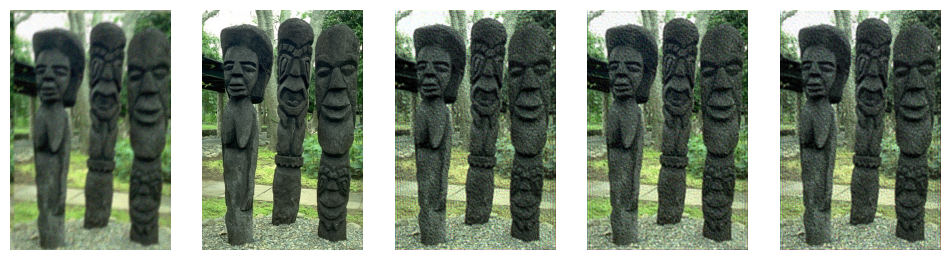

In [21]:
show_imgs([x_observed, x_truth, x_n, x_unbiased_fast, x_unbiased_proj_fast], figsize=(12, 4))

### Kernel n°1 + noise 0.1

In [56]:
support_z = current_dual != 0
support_z = torch.tensor(support_z, dtype=torch.float, device=DEVICE)
print(f"Proportion of zero elements in the dual: {np.mean(current_dual[0] == 0):.2%}")

Proportion of zero elements in the dual: 94.89%


100%|██████████| 1000/1000 [00:46<00:00, 21.69it/s]


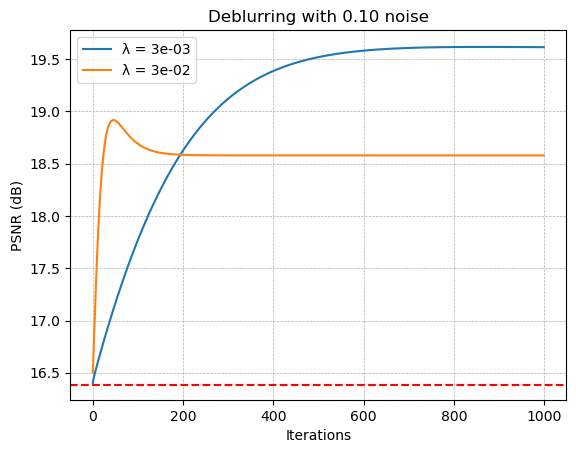

In [62]:
parameter = net.parameter

plt.figure()
for lamb in [3e-3, 3e-2]:#, 1e-1]:#, 1e-4, 1e-3]:

    z_n = current_dual.copy()
    z_n = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
    iter_grad = 1000
    step_size = gamma*1/net.compute_lipschitz()

    psnr_unbiased = []
    error_unbiased = []
    for i in tqdm(range(iter_grad)):
        grad = net.convt(z_n, net.parameter).detach().cpu().numpy()
        grad = Phi_channels(grad, Phi) - x_observed
        error_unbiased.append(np.linalg.norm(grad))
        grad = Phi_channels(grad, Phit)
        grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
        grad = net.conv(grad, net.parameter)
        z_n -= step_size * grad
        z_n = z_n * (1/(1+lamb))
        x_unbiased = net.convt(z_n, net.parameter).detach().cpu().numpy()[0]
        psnr_unbiased.append(peak_signal_noise_ratio(x_truth, x_unbiased))
        
    plt.plot(psnr_unbiased, label=f"λ = {lamb:.0e}")
    
plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()
plt.title(f"Deblurring with {std_noise:.2f} noise")
plt.axhline(psnr_final[-1], color='red', linestyle='--', label="SD")
plt.show()

  0%|          | 0/500 [00:00<?, ?it/s]

100%|██████████| 500/500 [00:23<00:00, 21.18it/s]


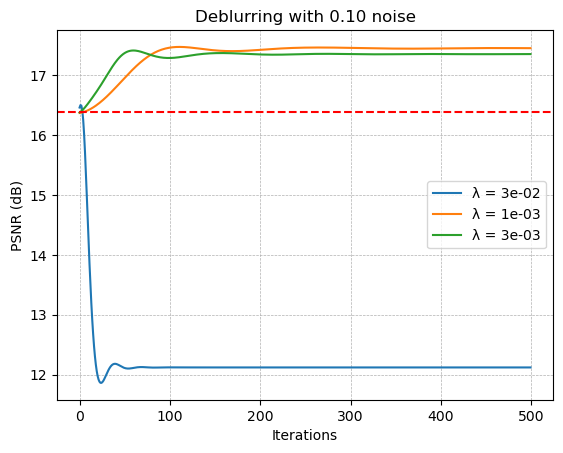

In [63]:
parameter = net.parameter

iter_grad = 500
step_size = gamma*1/net.compute_lipschitz()

plt.figure()
for lamb in [3e-2, 1e-3, 3e-3]:#, 1e-4, 1e-3]:

    z_n_proj_fast = current_dual.copy()
    z_n_proj_fast = torch.tensor(z_n_proj_fast, device=DEVICE, dtype=torch.float)
    w_n = z_n_proj_fast.clone()
    psnr_unbiased_proj_fast = []
    error_unbiased_proj_fast = []
    for i in tqdm(range(iter_grad)):
        old_z_n = z_n_proj_fast.clone()
        grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
        grad = Phi_channels(grad, Phi) - x_observed
        error_unbiased_proj_fast.append(np.linalg.norm(grad))
        grad = Phi_channels(grad, Phit)
        grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
        grad = net.conv(grad, net.parameter)
        w_n -= step_size * grad
        z_n_proj_fast = w_n * support_z * (1/(1+lamb))
        x_unbiased_proj_fast = net.convt(z_n_proj_fast, net.parameter).detach().cpu().numpy()[0]
        alpha_i = i / (i + 4)
        w_n = z_n_proj_fast + alpha_i * (z_n_proj_fast - old_z_n)
        psnr_unbiased_proj_fast.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj_fast))
    
    plt.plot(psnr_unbiased_proj_fast, label=f"λ = {lamb:.0e}")
    
plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()
plt.title(f"Deblurring with {std_noise:.2f} noise")
plt.axhline(psnr_final[-1], color='red', linestyle='--', label="SD")
plt.show()

### Kernel n°3 + noise = 0.2

In [31]:
support_z = current_dual != 0
support_z = torch.tensor(support_z, dtype=torch.float, device=DEVICE)
print(f"Proportion of zero elements in the dual: {np.mean(current_dual[0] == 0):.2%}")

Proportion of zero elements in the dual: 96.14%


In [93]:
parameter = net.parameter

z_n = current_dual.copy()
z_n = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
iter_grad = 1000
step_size = gamma*1/net.compute_lipschitz()

psnr_unbiased = []
error_unbiased = []
for i in tqdm(range(iter_grad)):
    grad = net.convt(z_n, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    z_n -= step_size * grad
    z_n = z_n * (1/(1+1e-4))
    x_unbiased = net.convt(z_n, net.parameter).detach().cpu().numpy()[0]
    psnr_unbiased.append(peak_signal_noise_ratio(x_truth, x_unbiased))


z_n_proj = current_dual.copy()
z_n_proj = torch.tensor(z_n_proj, device=DEVICE, dtype=torch.float)
psnr_unbiased_proj = []
error_unbiased_proj = []
for i in tqdm(range(iter_grad)):
    grad = net.convt(z_n_proj, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased_proj.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    z_n_proj -= step_size * grad
    z_n_proj = z_n_proj * support_z * (1/(1+1e-4))
    x_unbiased_proj = net.convt(z_n_proj, net.parameter).detach().cpu().numpy()[0]
    psnr_unbiased_proj.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj))

z_n_proj_fast = current_dual.copy()
z_n_proj_fast = torch.tensor(z_n_proj_fast, device=DEVICE, dtype=torch.float)
w_n = z_n_proj_fast.clone()
psnr_unbiased_proj_fast = []
error_unbiased_proj_fast = []
for i in tqdm(range(iter_grad)):
    old_z_n = z_n_proj_fast.clone()
    grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased_proj_fast.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    w_n -= step_size * grad
    z_n_proj_fast = w_n * support_z * (1/(1+1e-4))
    x_unbiased_proj_fast = net.convt(z_n_proj_fast, net.parameter).detach().cpu().numpy()[0]
    alpha_i = i / (i + 4)
    w_n = z_n_proj_fast + alpha_i * (z_n_proj_fast - old_z_n)
    psnr_unbiased_proj_fast.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj_fast))

100%|██████████| 1000/1000 [00:46<00:00, 21.54it/s]


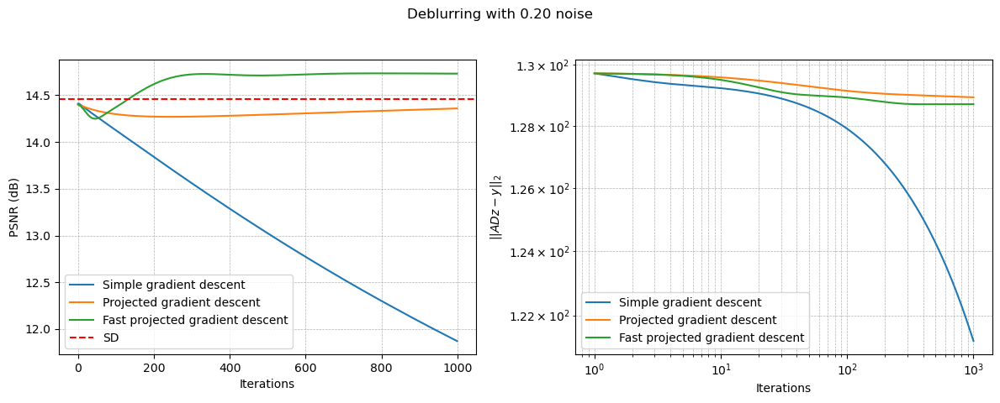

In [94]:
# Two plots side by side: PSNR and error
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(psnr_unbiased, label="Simple gradient descent")
plt.plot(psnr_unbiased_proj, label="Projected gradient descent")
plt.plot(psnr_unbiased_proj_fast, label="Fast projected gradient descent")
plt.axhline(psnr_final[-1], color='red', linestyle='--', label="SD")
plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()

plt.subplot(1, 2, 2)
plt.loglog(np.arange(1, len(error_unbiased) + 1), error_unbiased, label="Simple gradient descent")
plt.loglog(np.arange(1, len(error_unbiased_proj) + 1), error_unbiased_proj, label="Projected gradient descent")
plt.loglog(np.arange(1, len(error_unbiased_proj_fast) + 1), error_unbiased_proj_fast, label="Fast projected gradient descent")
plt.xlabel("Iterations")
plt.ylabel(rf"$|| ADz-y ||_2$")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()

plt.suptitle(f"Deblurring with {std_noise:.2f} noise")
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

100%|██████████| 1000/1000 [00:46<00:00, 21.55it/s]


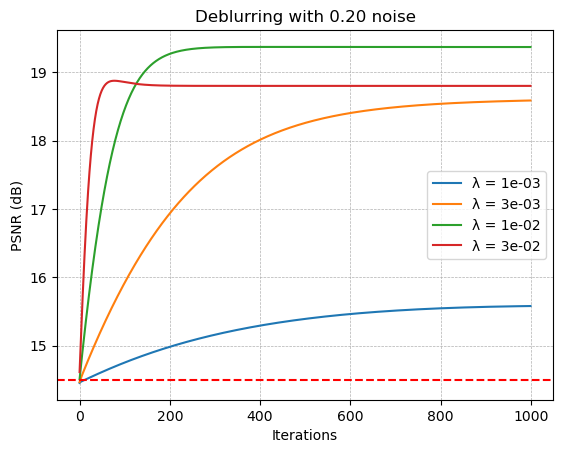

In [ ]:
parameter = net.parameter

z_n = current_dual.copy()
z_n = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
iter_grad = 500
step_size = gamma*1/net.compute_lipschitz()

plt.figure()
for lamb in [3e-3, 1e-2, 3e-2]:#, 1e-1]:#, 1e-4, 1e-3]:

    z_n = current_dual.copy()
    z_n = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
    iter_grad = 1000
    step_size = gamma*1/net.compute_lipschitz()

    psnr_unbiased = []
    error_unbiased = []
    for i in tqdm(range(iter_grad)):
        grad = net.convt(z_n, net.parameter).detach().cpu().numpy()
        grad = Phi_channels(grad, Phi) - x_observed
        error_unbiased.append(np.linalg.norm(grad))
        grad = Phi_channels(grad, Phit)
        grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
        grad = net.conv(grad, net.parameter)
        z_n -= step_size * grad
        z_n = z_n * (1/(1+lamb))
        x_unbiased = net.convt(z_n, net.parameter).detach().cpu().numpy()[0]
        psnr_unbiased.append(peak_signal_noise_ratio(x_truth, x_unbiased))
        
    plt.plot(psnr_unbiased, label=f"λ = {lamb:.0e}")
    
plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()
plt.title(f"Deblurring with {std_noise:.2f} noise")
plt.axhline(psnr_final[-1], color='red', linestyle='--', label="SD")
plt.show()

In [41]:
# Proportion of zero elements in vector z_n
print(f"Proportion of zero elements in the dual: {np.mean(z_n.cpu().numpy() == 0):.2%}")

Proportion of zero elements in the dual: 96.14%


  0%|          | 0/500 [00:00<?, ?it/s]

100%|██████████| 500/500 [00:23<00:00, 21.24it/s]


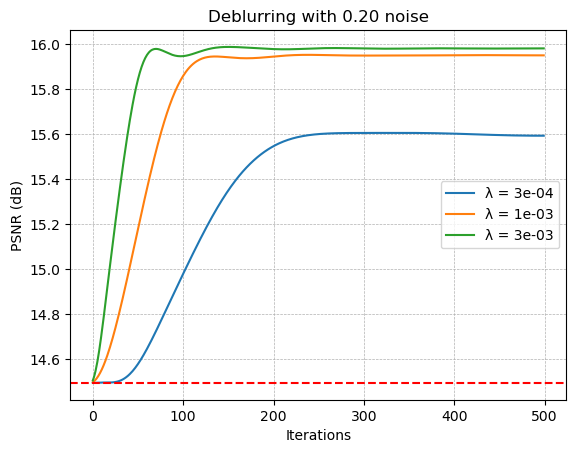

In [ ]:
parameter = net.parameter

z_n = current_dual.copy()
z_n = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
iter_grad = 500
step_size = gamma*1/net.compute_lipschitz()

plt.figure()
for lamb in [3e-4, 1e-3, 3e-3]:#, 1e-4, 1e-3]:

    z_n_proj_fast = current_dual.copy()
    z_n_proj_fast = torch.tensor(z_n_proj_fast, device=DEVICE, dtype=torch.float)
    w_n = z_n_proj_fast.clone()
    psnr_unbiased_proj_fast = []
    error_unbiased_proj_fast = []
    for i in tqdm(range(iter_grad)):
        old_z_n = z_n_proj_fast.clone()
        grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
        grad = Phi_channels(grad, Phi) - x_observed
        error_unbiased_proj_fast.append(np.linalg.norm(grad))
        grad = Phi_channels(grad, Phit)
        grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
        grad = net.conv(grad, net.parameter)
        w_n -= step_size * grad
        z_n_proj_fast = w_n * support_z * (1/(1+lamb))
        x_unbiased_proj_fast = net.convt(z_n_proj_fast, net.parameter).detach().cpu().numpy()[0]
        alpha_i = i / (i + 4)
        w_n = z_n_proj_fast + alpha_i * (z_n_proj_fast - old_z_n)
        psnr_unbiased_proj_fast.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj_fast))
    
    plt.plot(psnr_unbiased_proj_fast, label=f"λ = {lamb:.0e}")
    
plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()
plt.title(f"Deblurring with {std_noise:.2f} noise")
plt.axhline(psnr_final[-1], color='red', linestyle='--', label="SD")
plt.show()

In [86]:
peak_signal_noise_ratio(x_truth, x_unbiased_proj_fast.clip(0, 1)), peak_signal_noise_ratio(x_truth, x_unbiased_proj.clip(0, 1)), peak_signal_noise_ratio(x_truth, x_unbiased.clip(0, 1))

(15.035831715407877, 14.459875951246403, 12.353062149849412)

In [87]:
peak_signal_noise_ratio(x_truth, x_unbiased_proj_fast), peak_signal_noise_ratio(x_truth, x_unbiased_proj), peak_signal_noise_ratio(x_truth, x_unbiased)

(14.731359271985252, 14.359204878451319, 11.35263022762305)

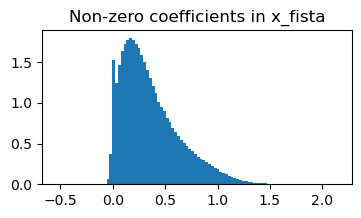

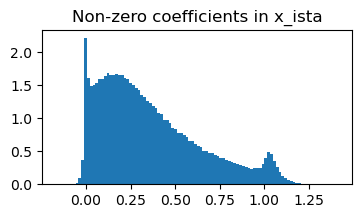

In [88]:
# Flatten non-null values of z_n_proj_fast
plt.figure(figsize=(4, 2))
x_unbiased_proj_fast_flat = x_unbiased_proj_fast.flatten()
plt.hist(x_unbiased_proj_fast_flat, bins=100, density=True)
plt.title("Non-zero coefficients in x_fista")
plt.show()

# Same for z_n_proj
plt.figure(figsize=(4, 2))
x_unbiased_proj_flat = x_unbiased_proj.flatten()
plt.hist(x_unbiased_proj_flat, bins=100, density=True)
plt.title("Non-zero coefficients in x_ista")
plt.show()

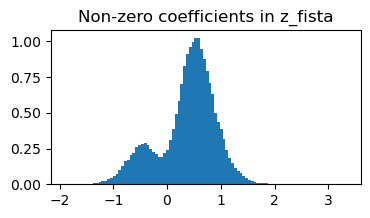

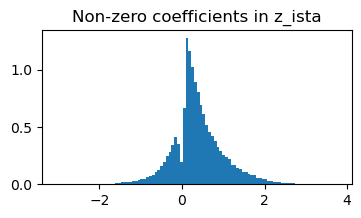

In [89]:
# Flatten non-null values of z_n_proj_fast
plt.figure(figsize=(4, 2))
z_n_proj_fast_flat = z_n_proj_fast.detach().cpu().numpy()
z_n_proj_fast_flat = z_n_proj_fast_flat[z_n_proj_fast_flat != 0]
plt.hist(z_n_proj_fast_flat, bins=100, density=True)
plt.title("Non-zero coefficients in z_fista")
plt.show()

# Same for z_n_proj
plt.figure(figsize=(4, 2))
z_n_proj_flat = z_n_proj.detach().cpu().numpy()
z_n_proj_flat = z_n_proj_flat[z_n_proj_flat != 0]
plt.hist(z_n_proj_flat, bins=100, density=True)
plt.title("Non-zero coefficients in z_ista")
plt.show()

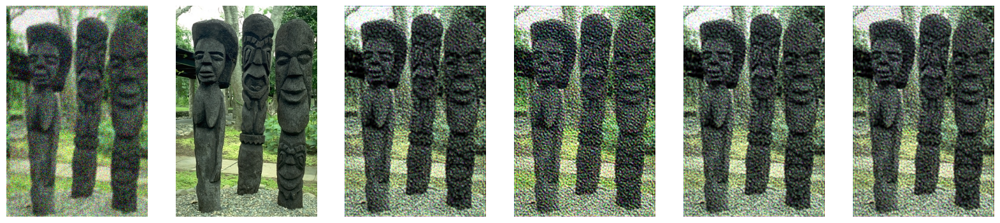

In [90]:
show_imgs([x_observed, x_truth, x_n, x_unbiased, x_unbiased_proj, x_unbiased_proj_fast], figsize=(20,6))

In [ ]:
parameter = net.parameter

z_n = np.zeros_like(current_dual)
z_n = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
iter_grad = 5000
step_size = gamma*1/net.compute_lipschitz()

psnr_unbiased = []
error_unbiased = []
for i in tqdm(range(iter_grad)):
    grad = net.convt(z_n, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    z_n -= step_size * grad
    x_unbiased = net.convt(z_n, net.parameter).detach().cpu().numpy()[0]
    psnr_unbiased.append(peak_signal_noise_ratio(x_truth, x_unbiased))


z_n_proj = np.zeros_like(current_dual)
z_n_proj = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
psnr_unbiased_proj = []
error_unbiased_proj = []
for i in tqdm(range(iter_grad)):
    grad = net.convt(z_n_proj, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased_proj.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    z_n_proj -= step_size * grad
    z_n_proj = z_n_proj * support_z
    x_unbiased_proj = net.convt(z_n_proj, net.parameter).detach().cpu().numpy()[0]
    psnr_unbiased_proj.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj))

z_n_proj_fast = np.zeros_like(current_dual)
z_n_proj_fast = torch.tensor(z_n_proj_fast, device=DEVICE, dtype=torch.float)
w_n = z_n_proj_fast.clone()
psnr_unbiased_proj_fast = []
error_unbiased_proj_fast = []
for i in tqdm(range(iter_grad)):
    old_z_n = z_n_proj_fast.clone()
    grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased_proj_fast.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    w_n -= step_size * grad + 1e-6
    z_n_proj_fast = w_n * support_z
    x_unbiased_proj_fast = net.convt(z_n_proj_fast, net.parameter).detach().cpu().numpy()[0]
    alpha_i = i / (i + 4)
    w_n = z_n_proj_fast + alpha_i * (z_n_proj_fast - old_z_n)
    psnr_unbiased_proj_fast.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj_fast))

  0%|          | 0/5000 [00:00<?, ?it/s]

100%|██████████| 5000/5000 [03:52<00:00, 21.53it/s]


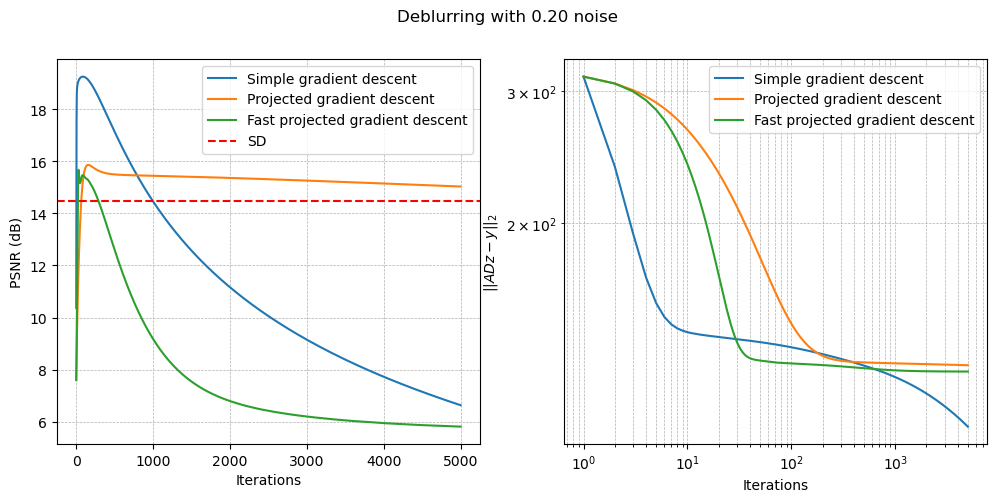

In [13]:
# Two plots side by side: PSNR and error
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(psnr_unbiased, label="Simple gradient descent")
plt.plot(psnr_unbiased_proj, label="Projected gradient descent")
plt.plot(psnr_unbiased_proj_fast, label="Fast projected gradient descent")
plt.axhline(psnr_final[-1], color='red', linestyle='--', label="SD")
plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()

plt.subplot(1, 2, 2)
plt.loglog(np.arange(1, len(error_unbiased) + 1), error_unbiased, label="Simple gradient descent")
plt.loglog(np.arange(1, len(error_unbiased_proj) + 1), error_unbiased_proj, label="Projected gradient descent")
plt.loglog(np.arange(1, len(error_unbiased_proj_fast) + 1), error_unbiased_proj_fast, label="Fast projected gradient descent")
plt.xlabel("Iterations")
plt.ylabel(rf"$|| ADz-y ||_2$")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()

plt.suptitle(f"Deblurring with {std_noise:.2f} noise")
plt.show()

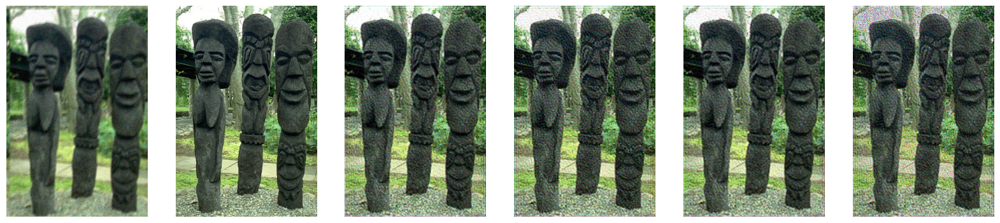

In [ ]:
show_imgs([x_observed, x_truth, x_n, x_unbiased, x_unbiased_proj, x_unbiased_proj_fast], figsize=(20,6))

### Kernel n°3 + noise = 0.05

In [24]:
support_z = current_dual != 0
support_z = torch.tensor(support_z, dtype=torch.float, device=DEVICE)
print(f"Proportion of zero elements in the dual: {np.mean(current_dual[0] == 0):.2%}")

Proportion of zero elements in the dual: 0.00%


In [27]:
# Proportion of elements smaller than 1e-3 in the dual
print(f"Proportion of elements smaller than 1e-3 in the dual: {np.mean(np.abs(current_dual[0]) < 1e-3):.2%}")

Proportion of elements smaller than 1e-3 in the dual: 0.46%


In [ ]:
parameter = net.parameter

z_n = current_dual.copy()
z_n = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
iter_grad = 2500
step_size = gamma*1/net.compute_lipschitz()

psnr_unbiased = []
error_unbiased = []
for i in tqdm(range(iter_grad)):
    grad = net.convt(z_n, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    z_n -= step_size * grad
    z_n = z_n * (1/(1+1e-3))
    x_unbiased = net.convt(z_n, net.parameter).detach().cpu().numpy()[0]
    psnr_unbiased.append(peak_signal_noise_ratio(x_truth, x_unbiased))

100%|██████████| 2500/2500 [01:55<00:00, 21.67it/s]
/tmp/ipykernel_1247188/3642182340.py:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  z_n_fast = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
100%|██████████| 2500/2500 [01:56<00:00, 21.46it/s]


In [16]:
z_n_fast = current_dual.copy()
z_n_fast = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
w_n = z_n_fast.clone()
psnr_unbiased_fast = []
error_unbiased_fast = []
for i in tqdm(range(iter_grad)):
    old_z_n = z_n_fast.clone()
    grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased_fast.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    w_n -= step_size * grad
    z_n_fast = w_n * (1/(1+1e-3))
    x_unbiased_fast = net.convt(z_n_fast, net.parameter).detach().cpu().numpy()[0]
    alpha_i = i / (i + 4)
    w_n = z_n_fast + alpha_i * (z_n_fast - old_z_n)
    psnr_unbiased_fast.append(peak_signal_noise_ratio(x_truth, x_unbiased_fast))

/tmp/ipykernel_1247188/2372088144.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  z_n_fast = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
100%|██████████| 2500/2500 [01:56<00:00, 21.39it/s]


In [19]:
z_n_fast_zero = np.zeros_like(current_dual)
z_n_fast_zero = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
w_n = z_n_fast_zero.clone()
psnr_unbiased_fast_zero = []
error_unbiased_fast_zero = []
for i in tqdm(range(iter_grad)):
    old_z_n = z_n_fast_zero.clone()
    grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased_fast_zero.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    w_n -= step_size * grad
    z_n_fast_zero = w_n * (1/(1+1e-3))
    x_unbiased_fast_zero = net.convt(z_n_fast_zero, net.parameter).detach().cpu().numpy()[0]
    alpha_i = i / (i + 4)
    w_n = z_n_fast_zero + alpha_i * (z_n_fast_zero - old_z_n)
    psnr_unbiased_fast_zero.append(peak_signal_noise_ratio(x_truth, x_unbiased_fast_zero))

/tmp/ipykernel_1247188/528456137.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  z_n_fast_zero = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
100%|██████████| 2500/2500 [01:56<00:00, 21.47it/s]


In [15]:
z_n_proj = current_dual.copy()
z_n_proj = torch.tensor(z_n_proj, device=DEVICE, dtype=torch.float)
psnr_unbiased_proj = []
error_unbiased_proj = []
for i in tqdm(range(iter_grad)):
    grad = net.convt(z_n_proj, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased_proj.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    z_n_proj -= step_size * grad
    z_n_proj = z_n_proj * support_z * (1/(1+1e-3))
    x_unbiased_proj = net.convt(z_n_proj, net.parameter).detach().cpu().numpy()[0]
    psnr_unbiased_proj.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj))

 95%|█████████▍| 4746/5000 [03:41<00:11, 21.42it/s]


OutOfMemoryError: CUDA out of memory. Tried to allocate 20.00 MiB. GPU 0 has a total capacity of 19.54 GiB of which 2.06 MiB is free. Including non-PyTorch memory, this process has 19.38 GiB memory in use. Of the allocated memory 17.87 GiB is allocated by PyTorch, and 1.32 GiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

In [ ]:
z_n_proj_fast = current_dual.copy()
z_n_proj_fast = torch.tensor(z_n_proj_fast, device=DEVICE, dtype=torch.float)
w_n = z_n_proj_fast.clone()
psnr_unbiased_proj_fast = []
error_unbiased_proj_fast = []
for i in tqdm(range(iter_grad)):
    old_z_n = z_n_proj_fast.clone()
    grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased_proj_fast.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    w_n -= step_size * grad
    z_n_proj_fast = w_n * support_z * (1/(1+1e-3))
    x_unbiased_proj_fast = net.convt(z_n_proj_fast, net.parameter).detach().cpu().numpy()[0]
    alpha_i = i / (i + 4)
    w_n = z_n_proj_fast + alpha_i * (z_n_proj_fast - old_z_n)
    psnr_unbiased_proj_fast.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj_fast))

In [22]:
psnr_unbiased_fast

[21.562066236776975,
 21.56211626994981,
 21.56217588329833,
 21.562250985534064,
 21.562335264511727,
 21.56243485155153,
 21.56253981988496,
 21.562654020343174,
 21.562784265415488,
 21.562918790750018,
 21.563062232469868,
 21.563226723676667,
 21.563387981523388,
 21.56355577036757,
 21.563746301250376,
 21.56393536493331,
 21.56413117019443,
 21.564344639861556,
 21.56456314435253,
 21.564783894887725,
 21.565020945549595,
 21.565254979240613,
 21.565495191097273,
 21.56575187209625,
 21.566010843654762,
 21.566265720966275,
 21.56653684656636,
 21.56682253243186,
 21.56709810090905,
 21.567387781152494,
 21.56767595880966,
 21.567966990012316,
 21.568268195741233,
 21.568569143889924,
 21.568881888330314,
 21.569175692314975,
 21.569489135209977,
 21.569799023344686,
 21.5701171794894,
 21.570436715855376,
 21.570748698730334,
 21.571063795754256,
 21.57137880080154,
 21.571698605278936,
 21.572016221608923,
 21.572332747412908,
 21.57265420071341,
 21.572972747288137,
 21.57328

In [21]:
psnr_unbiased_fast_zero

[21.562066236776975,
 21.56211626994981,
 21.56217588329833,
 21.562250985534064,
 21.562335264511727,
 21.56243485155153,
 21.56253981988496,
 21.562654020343174,
 21.562784265415488,
 21.562918790750018,
 21.563062232469868,
 21.563226723676667,
 21.563387981523388,
 21.56355577036757,
 21.563746301250376,
 21.56393536493331,
 21.56413117019443,
 21.564344639861556,
 21.56456314435253,
 21.564783894887725,
 21.565020945549595,
 21.565254979240613,
 21.565495191097273,
 21.56575187209625,
 21.566010843654762,
 21.566265720966275,
 21.56653684656636,
 21.56682253243186,
 21.56709810090905,
 21.567387781152494,
 21.56767595880966,
 21.567966990012316,
 21.568268195741233,
 21.568569143889924,
 21.568881888330314,
 21.569175692314975,
 21.569489135209977,
 21.569799023344686,
 21.5701171794894,
 21.570436715855376,
 21.570748698730334,
 21.571063795754256,
 21.57137880080154,
 21.571698605278936,
 21.572016221608923,
 21.572332747412908,
 21.57265420071341,
 21.572972747288137,
 21.57328

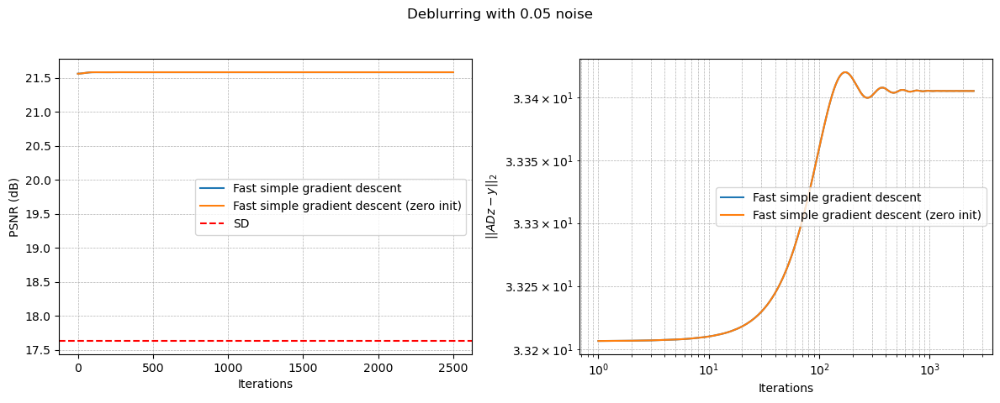

In [20]:
# Two plots side by side: PSNR and error
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
#plt.plot(psnr_unbiased, label="Simple gradient descent")
plt.plot(psnr_unbiased_fast, label="Fast simple gradient descent")
plt.plot(psnr_unbiased_fast_zero, label="Fast simple gradient descent (zero init)")
# plt.plot(psnr_unbiased_proj, label="Projected gradient descent")
# plt.plot(psnr_unbiased_proj_fast, label="Fast projected gradient descent")
plt.axhline(psnr_final[-1], color='red', linestyle='--', label="SD")
plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()

plt.subplot(1, 2, 2)
#plt.loglog(np.arange(1, len(error_unbiased) + 1), error_unbiased, label="Simple gradient descent")
plt.loglog(np.arange(1, len(error_unbiased_fast) + 1), error_unbiased_fast, label="Fast simple gradient descent")
plt.loglog(np.arange(1, len(error_unbiased_fast_zero) + 1), error_unbiased_fast_zero, label="Fast simple gradient descent (zero init)")
# plt.loglog(np.arange(1, len(error_unbiased_proj) + 1), error_unbiased_proj, label="Projected gradient descent")
# plt.loglog(np.arange(1, len(error_unbiased_proj_fast) + 1), error_unbiased_proj_fast, label="Fast projected gradient descent")
plt.xlabel("Iterations")
plt.ylabel(rf"$|| ADz-y ||_2$")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()

plt.suptitle(f"Deblurring with {std_noise:.2f} noise")
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

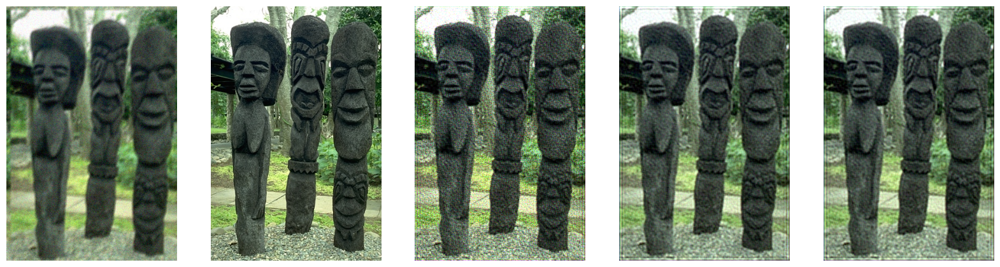

In [18]:
show_imgs([x_observed, x_truth, x_n, x_unbiased, x_unbiased_fast], figsize=(20,6))

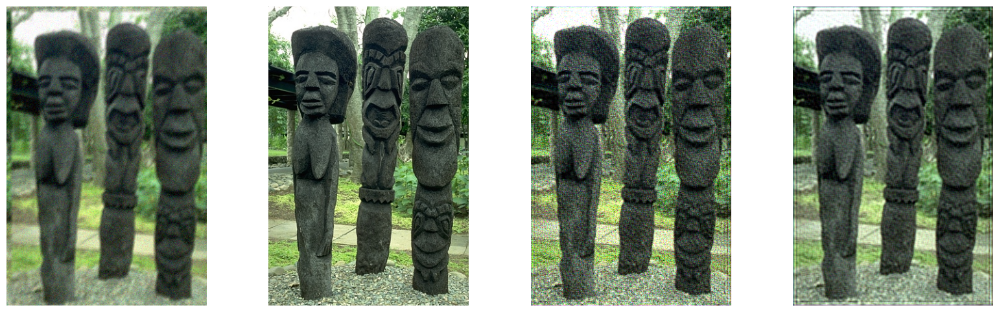

In [18]:
show_imgs([x_observed, x_truth, x_n, x_unbiased], figsize=(20,6))

  0%|          | 0/1000 [00:00<?, ?it/s]

100%|██████████| 1000/1000 [00:46<00:00, 21.57it/s]


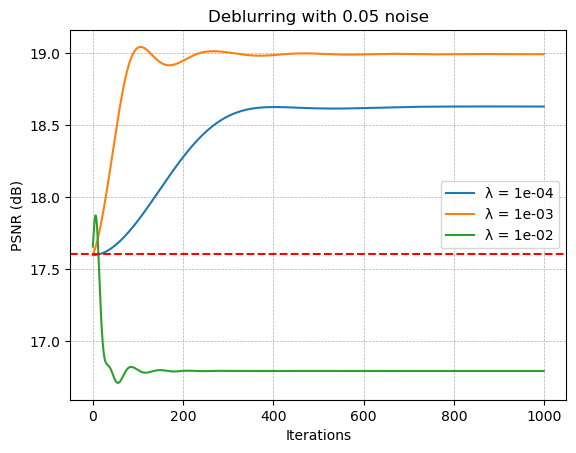

In [20]:
parameter = net.parameter

z_n = current_dual.copy()
z_n = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
iter_grad = 1000
step_size = gamma*1/net.compute_lipschitz()

plt.figure()
for lamb in [1e-4, 1e-3, 1e-2]:#, 1e-4, 1e-3]:

    z_n_proj_fast = current_dual.copy()
    z_n_proj_fast = torch.tensor(z_n_proj_fast, device=DEVICE, dtype=torch.float)
    w_n = z_n_proj_fast.clone()
    psnr_unbiased_proj_fast = []
    error_unbiased_proj_fast = []
    for i in tqdm(range(iter_grad)):
        old_z_n = z_n_proj_fast.clone()
        grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
        grad = Phi_channels(grad, Phi) - x_observed
        error_unbiased_proj_fast.append(np.linalg.norm(grad))
        grad = Phi_channels(grad, Phit)
        grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
        grad = net.conv(grad, net.parameter)
        w_n -= step_size * grad
        z_n_proj_fast = w_n * support_z * (1/(1+lamb))
        x_unbiased_proj_fast = net.convt(z_n_proj_fast, net.parameter).detach().cpu().numpy()[0]
        alpha_i = i / (i + 4)
        w_n = z_n_proj_fast + alpha_i * (z_n_proj_fast - old_z_n)
        psnr_unbiased_proj_fast.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj_fast))
    
    plt.plot(psnr_unbiased_proj_fast, label=f"λ = {lamb:.0e}")
    
plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()
plt.title(f"Deblurring with {std_noise:.2f} noise")
plt.axhline(psnr_final[-1], color='red', linestyle='--', label="SD")
plt.show()

In [16]:
parameter = net.parameter

z_n = np.zeros_like(current_dual)
z_n = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
iter_grad = 5000
step_size = gamma*1/net.compute_lipschitz()

psnr_unbiased = []
error_unbiased = []
for i in tqdm(range(iter_grad)):
    grad = net.convt(z_n, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    z_n -= step_size * grad
    x_unbiased = net.convt(z_n, net.parameter).detach().cpu().numpy()[0]
    psnr_unbiased.append(peak_signal_noise_ratio(x_truth, x_unbiased))


z_n = np.zeros_like(current_dual)
z_n = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
psnr_unbiased_proj = []
error_unbiased_proj = []
for i in tqdm(range(iter_grad)):
    grad = net.convt(z_n, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased_proj.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    z_n -= step_size * grad
    z_n = z_n * support_z
    x_unbiased_proj = net.convt(z_n, net.parameter).detach().cpu().numpy()[0]
    psnr_unbiased_proj.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj))

z_n = np.zeros_like(current_dual)
z_n = torch.tensor(z_n, device=DEVICE, dtype=torch.float)
w_n = z_n.clone()
psnr_unbiased_proj_fast = []
error_unbiased_proj_fast = []
for i in tqdm(range(iter_grad)):
    old_z_n = z_n.clone()
    grad = net.convt(w_n, net.parameter).detach().cpu().numpy()
    grad = Phi_channels(grad, Phi) - x_observed
    error_unbiased_proj_fast.append(np.linalg.norm(grad))
    grad = Phi_channels(grad, Phit)
    grad = torch.tensor(grad, device=DEVICE, dtype=torch.float)
    grad = net.conv(grad, net.parameter)
    w_n -= step_size * grad
    z_n = w_n * support_z
    x_unbiased_proj_fast = net.convt(z_n, net.parameter).detach().cpu().numpy()[0]
    alpha_i = i / (i + 4)
    w_n = z_n + alpha_i * (z_n - old_z_n)
    psnr_unbiased_proj_fast.append(peak_signal_noise_ratio(x_truth, x_unbiased_proj_fast))

  0%|          | 0/5000 [00:00<?, ?it/s]

100%|██████████| 5000/5000 [03:52<00:00, 21.48it/s]


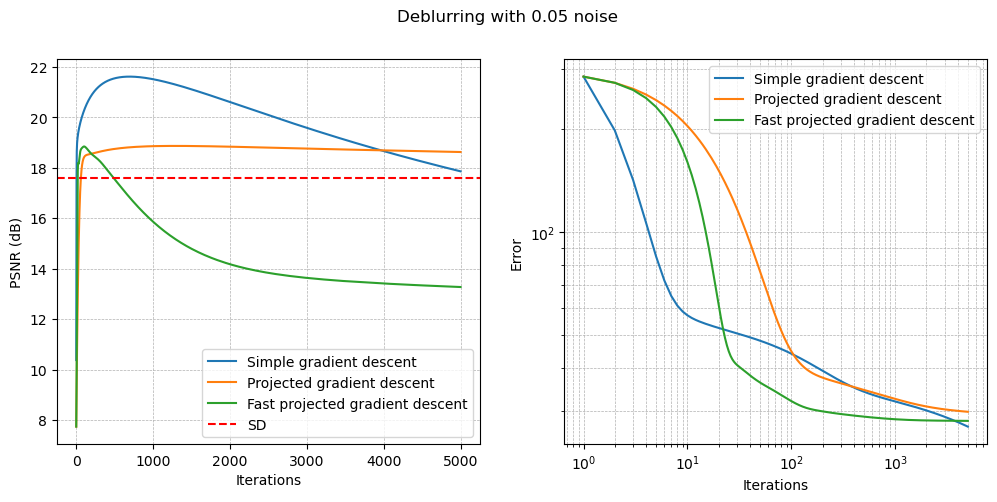

In [17]:
# Two plots side by side: PSNR and error
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(psnr_unbiased, label="Simple gradient descent")
plt.plot(psnr_unbiased_proj, label="Projected gradient descent")
plt.plot(psnr_unbiased_proj_fast, label="Fast projected gradient descent")
plt.axhline(psnr_final[-1], color='red', linestyle='--', label="SD")
plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()

plt.subplot(1, 2, 2)
plt.loglog(np.arange(1, len(error_unbiased) + 1), error_unbiased, label="Simple gradient descent")
plt.loglog(np.arange(1, len(error_unbiased_proj) + 1), error_unbiased_proj, label="Projected gradient descent")
plt.loglog(np.arange(1, len(error_unbiased_proj_fast) + 1), error_unbiased_proj_fast, label="Fast projected gradient descent")
plt.xlabel("Iterations")
plt.ylabel("Error")
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()

plt.suptitle(f"Deblurring with {std_noise:.2f} noise")
plt.show()

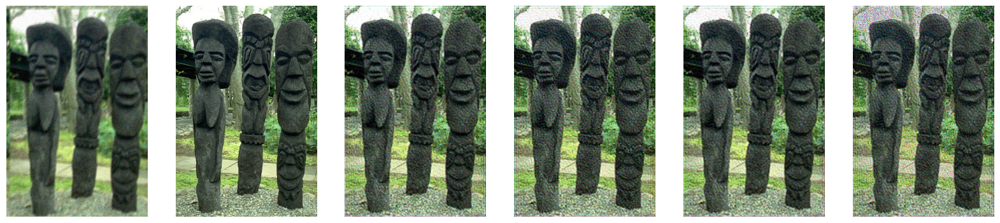

In [18]:
show_imgs([x_observed, x_truth, x_n, x_unbiased, x_unbiased_proj, x_unbiased_proj_fast], figsize=(20,6))

### Synthesis

In [133]:
denoiser_names = ["SD_10C_1L_1R", "SD_10C_1L_20R", "SD_10C_1L_100R"]


Running denoiser: SD_10C_1L_1R
lambda_max: 5.470734596252441


100%|██████████| 50/50 [01:58<00:00,  2.37s/it]


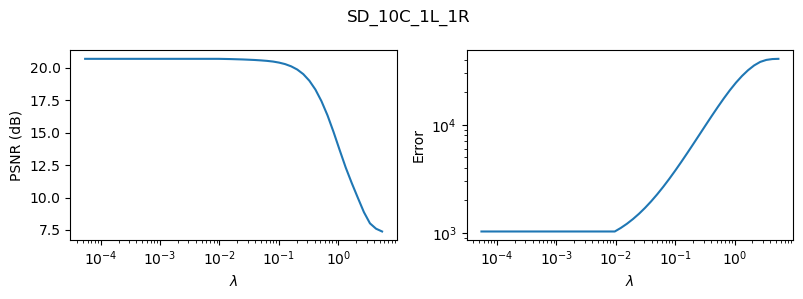

100%|██████████| 1000/1000 [01:19<00:00, 12.63it/s]


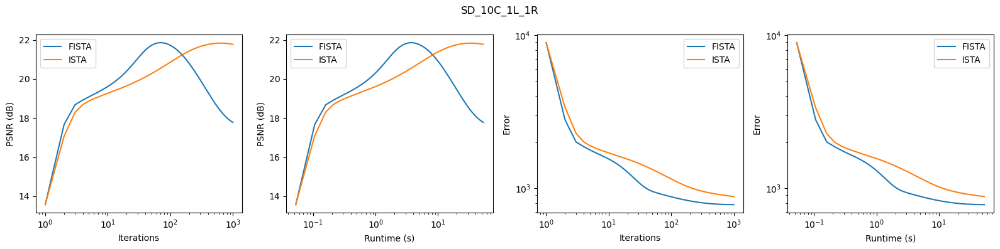


Running denoiser: SD_10C_1L_20R
lambda_max: 5.470734596252441


100%|██████████| 50/50 [03:42<00:00,  4.44s/it]


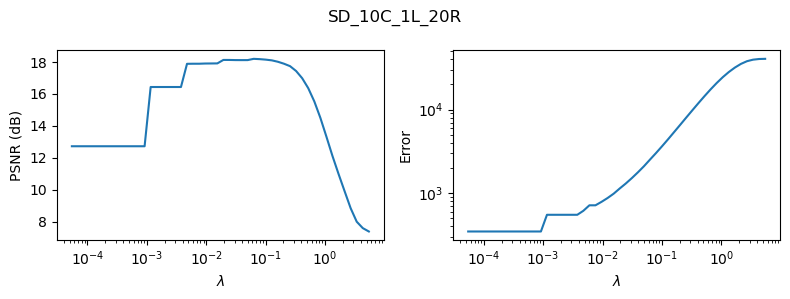

100%|██████████| 1000/1000 [01:26<00:00, 11.55it/s]


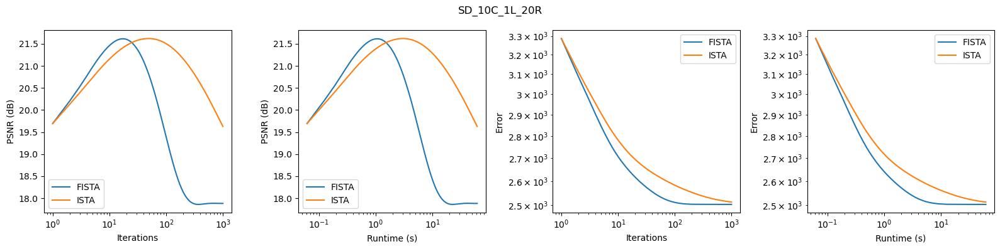


Running denoiser: SD_10C_1L_100R
lambda_max: 5.470734596252441


100%|██████████| 50/50 [05:07<00:00,  6.15s/it]


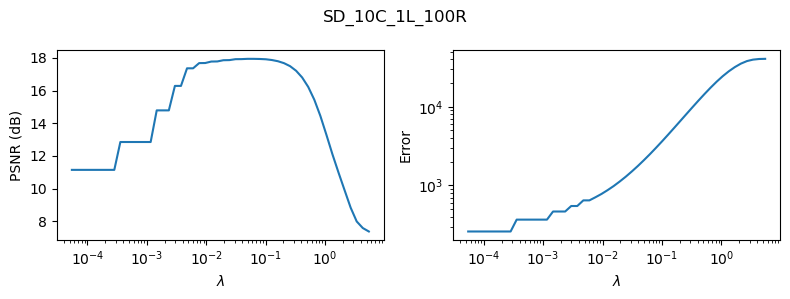

100%|██████████| 1000/1000 [02:04<00:00,  8.03it/s]


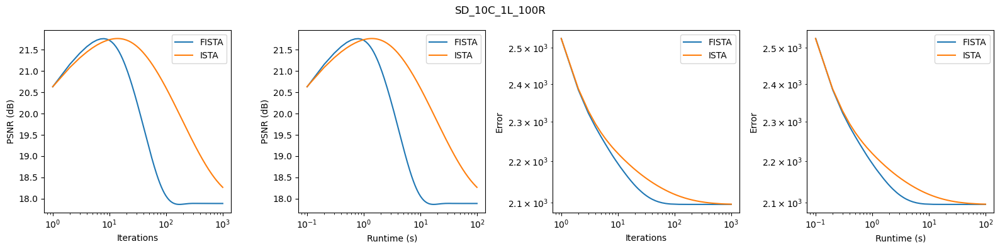

In [146]:
eps_stop = 5e-7

for denoiser_name in denoiser_names:
    
    print(f"\nRunning denoiser: {denoiser_name}")

    denoiser = DENOISERS[denoiser_name]
    net = denoiser["net"]
    model = "unrolled"
    model_type = denoiser["model"]

    lambda_max = lambda_max_synthesis(x_observed, denoiser["net"], Phit)
    lambda_list = np.logspace(np.log10(1*lambda_max), np.log10(1e-5 * lambda_max), n_lambda)
    n_iter_per_lambda = 200

    n_lambda = len(lambda_list)
    if lambda_list is None:
        lambda_list = [0.5 * std_noise] * n_lambda

    x_n = Phi_channels(x_observed, Phit)
    best_x_psnr = x_n.copy()
    best_x_error = x_n.copy()
    best_psnr = 0
    best_error = 0
    best_lambda = 0

    cvg = [1e10] * n_lambda*n_iter_per_lambda
    psnr = [0] * n_lambda
    error = [0] * n_lambda
    psnr_inner = [0] * n_lambda*n_iter_per_lambda
    error_inner = [0] * n_lambda*n_iter_per_lambda
    runtime = [0] * n_lambda*n_iter_per_lambda
    stops = [0] * (n_lambda+1)

    current_dual = None
    current_dual_fast = None

    best_current_dual, best_current_dual_fast = None, None

    t_iter = 0

    i = 0
    for k in tqdm(range(n_lambda)):
        if not warm_restart:
            x_n = Phi_channels(x_observed, Phit)
            current_dual = None
            current_dual_fast = None
        
        for t in range(n_iter_per_lambda):
            t_start = time.perf_counter()
            g_n = Phi_channels((Phi_channels(x_n, Phi) - x_observed), Phit)
            tmp = x_n - gamma * g_n
            x_old = x_n.copy()

            if model_type != "synthesis":
                x_n, current_dual = apply_model(
                    model, tmp, current_dual, lambda_list[k], net, True
                )
            else:
                alpha = t/(t+4)
                #alpha = 0
                x_n, current_dual, current_dual_fast = apply_model(
                    model, tmp, current_dual, lambda_list[k], net, True,
                    fast=True, dual_fast=current_dual_fast, alpha_fast=alpha
                )
            
            t_iter += time.perf_counter() - t_start
            cvg[i] = np.sum((x_n - x_old) ** 2)
            runtime[i] = t_iter
            psnr_inner[i] = peak_signal_noise_ratio(x_n, x_truth)
            criterion = np.sum((x_n - x_old) ** 2 / np.sum(x_old ** 2))
            
            if model_type == "analysis":
                error_inner[i] = error_analysis(x_n, x_observed, net, Phi, lambda_list[k])
            elif model_type == "synthesis":
                error_inner[i] = error_synthesis(current_dual[0], x_observed, net, Phi, lambda_list[k])
                
            if eps_stop is not None and criterion < eps_stop:
                break
            i += 1
        
        stops[k+1] = i
        
        if x_truth is not None:
            psnr[k] = psnr_inner[i-1]
            error[k] = error_inner[i-1]
            if psnr[k] > best_psnr:
                best_psnr = psnr[k]
                best_x_psnr = x_n.copy()
                best_lambda = lambda_list[k]
                best_current_dual = current_dual.copy() if current_dual is not None else None
                best_current_dual_fast = current_dual_fast.copy() if current_dual_fast is not None else None
            if error[k] < best_error:
                best_error = error[k]
                best_x_error = x_n.copy()
    
    # Plot PSNR vs lambda and error vs lambda on 2 subplots
    plt.figure(figsize=(8, 3))
    plt.subplot(1, 2, 1)
    plt.semilogx(lambda_list, psnr)
    plt.xlabel(r"$\lambda$")
    plt.ylabel("PSNR (dB)")
    
    plt.subplot(1, 2, 2)
    plt.loglog(lambda_list, error)
    plt.xlabel(r"$\lambda$")
    plt.ylabel("Error")
    plt.suptitle(f"{denoiser_name}")
    plt.tight_layout()
    plt.show()
    
    x_n = Phi_channels(x_observed, Phit)
    current_dual = None
    current_dual_fast = None

    iter_final = 1000
    error_final = [0] * iter_final
    psnr_final = [0] * iter_final
    best_psnr = 0
    runtime_final = [0] * iter_final
    cvg_final = [0] * iter_final
    t_iter = 0
    update_dual = True

    for t in tqdm(range(iter_final)):
        
        t_start = time.perf_counter()

        g_n = Phi_channels((Phi_channels(x_n, Phi) - x_observed), Phit)
        tmp = x_n - gamma * g_n
        
        
        x_old = x_n.copy()
        alpha = t/(t+4)
        #alpha = 0
        x_n, current_dual, current_dual_fast = apply_model(
            model, tmp, current_dual, best_lambda, net, update_dual,
            fast=True, dual_fast=current_dual_fast, alpha_fast=alpha
        )

        t_iter += time.perf_counter() - t_start
        runtime_final[t] = t_iter
        cvg_final[t] = np.sum((x_n - x_old) ** 2)
        psnr_final[t] = peak_signal_noise_ratio(x_n, x_truth)
        error_final[t] = error_synthesis(current_dual[0], x_observed, net, Phi, best_lambda)
        
        if psnr_final[t] > best_psnr:
            best_x = x_n.copy()
            best_dual = current_dual.copy()
            best_psnr = psnr_final[t]

    x_n = Phi_channels(x_observed, Phit)
    current_dual = None
    current_dual_fast = None

    error_final_ista = [0] * iter_final
    psnr_final_ista = [0] * iter_final
    best_psnr_ista = 0
    runtime_final_ista = [0] * iter_final
    cvg_final_ista = [0] * iter_final
    t_iter = 0
    update_dual = True

    for t in tqdm(range(iter_final)):
        
        t_start = time.perf_counter()

        g_n = Phi_channels((Phi_channels(x_n, Phi) - x_observed), Phit)
        tmp = x_n - gamma * g_n
        
        
        x_old = x_n.copy()
        #alpha = t/(t+4)
        alpha = 0
        x_n, current_dual, current_dual_fast = apply_model(
            model, tmp, current_dual, best_lambda, net, update_dual,
            fast=True, dual_fast=current_dual_fast, alpha_fast=alpha
        )

        t_iter += time.perf_counter() - t_start
        runtime_final_ista[t] = t_iter
        cvg_final_ista[t] = np.sum((x_n - x_old) ** 2)
        psnr_final_ista[t] = peak_signal_noise_ratio(x_n, x_truth)
        error_final_ista[t] = error_synthesis(current_dual[0], x_observed, net, Phi, best_lambda)
        
        if psnr_final_ista[t] > best_psnr_ista:
            best_x_ista = x_n.copy()
            best_dual = current_dual.copy()
            best_psnr_ista = psnr_final_ista[t]

    plt.figure(figsize=(16, 4))

    plt.subplot(1, 4, 1)
    plt.semilogx(np.arange(1, iter_final + 1), psnr_final, label="FISTA")
    plt.semilogx(np.arange(1, iter_final + 1), psnr_final_ista, label="ISTA")
    plt.xlabel("Iterations")
    plt.ylabel("PSNR (dB)")
    plt.legend()

    plt.subplot(1, 4, 2)
    plt.semilogx(runtime_final, psnr_final, label="FISTA")
    plt.semilogx(runtime_final_ista, psnr_final_ista, label="ISTA")
    plt.xlabel("Runtime (s)")
    plt.ylabel("PSNR (dB)")
    plt.legend()

    plt.subplot(1, 4, 3)
    plt.loglog(np.arange(1, iter_final + 1), error_final, label="FISTA")
    plt.loglog(np.arange(1, iter_final + 1), error_final_ista, label="ISTA")
    plt.xlabel("Iterations")
    plt.ylabel("Error")
    plt.legend()

    plt.subplot(1, 4, 4)
    plt.loglog(runtime_final, error_final, label="FISTA")
    plt.loglog(runtime_final_ista, error_final_ista, label="ISTA")
    plt.xlabel("Runtime (s)")
    plt.ylabel("Error")
    plt.legend()

    plt.suptitle(f"{denoiser_name}")
    plt.tight_layout()
    plt.show()


Running denoiser: SD_10C_1L_1R


100%|██████████| 3/3 [07:43<00:00, 154.66s/it]


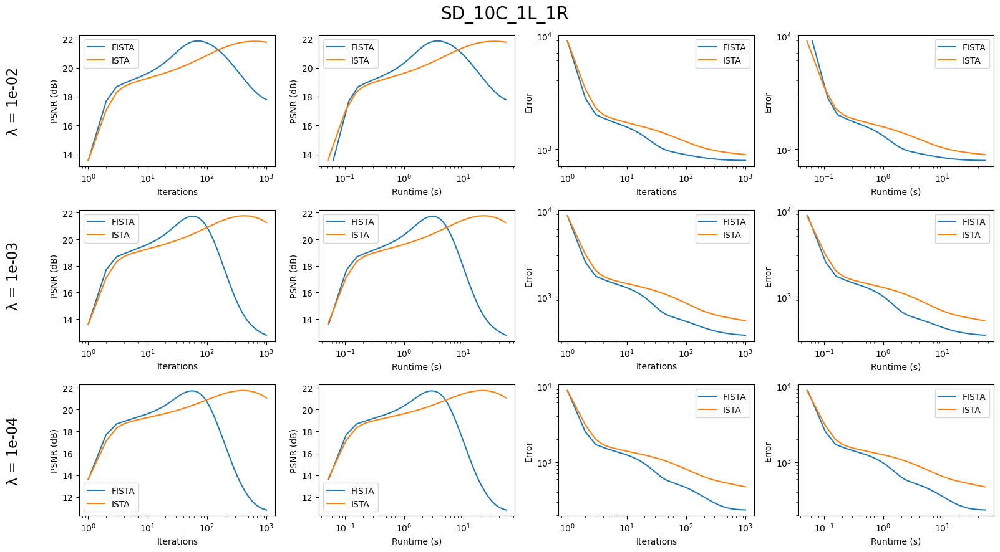


Running denoiser: SD_10C_1L_20R


100%|██████████| 3/3 [08:34<00:00, 171.44s/it]


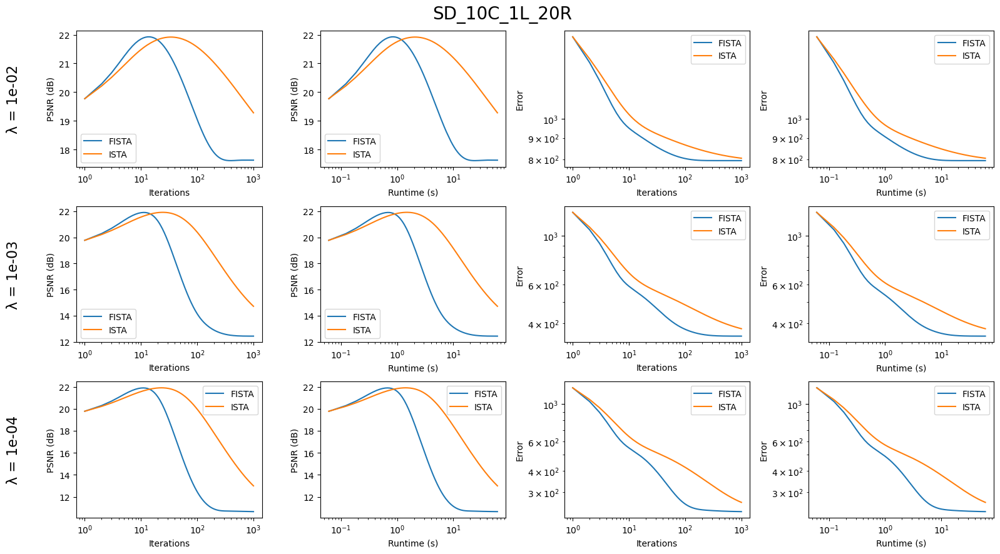


Running denoiser: SD_10C_1L_100R


100%|██████████| 3/3 [12:22<00:00, 247.58s/it]


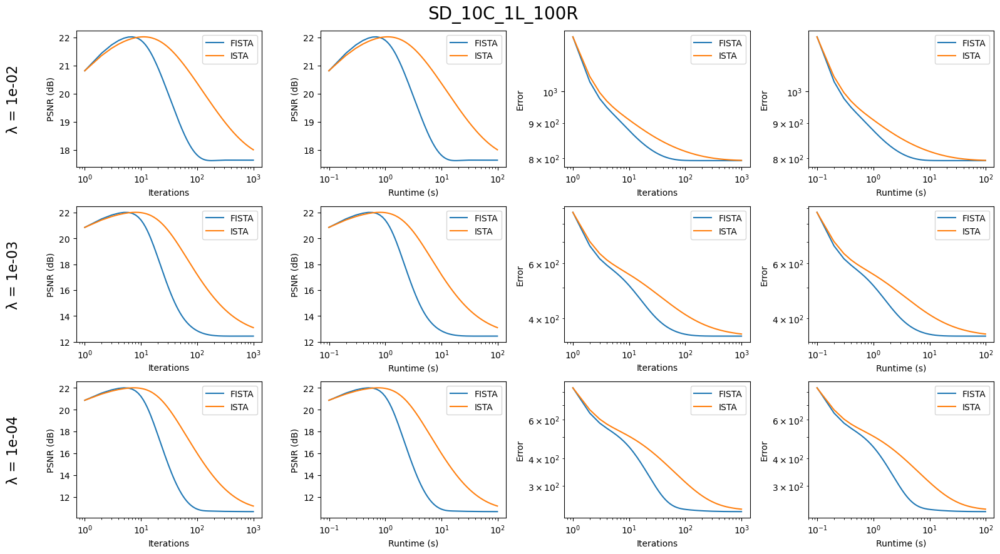

In [ ]:
for denoiser_name in denoiser_names:
    
    print(f"\nRunning denoiser: {denoiser_name}")

    denoiser = DENOISERS[denoiser_name]
    net = denoiser["net"]
    model = "unrolled"
    
    lambdas = [1e-2, 1e-3, 1e-4]
    n = len(lambdas)
    plt.figure(figsize=(16, 3*n))
    i = 0
    
    for best_lambda in tqdm(lambdas):
        
        x_n = Phi_channels(x_observed, Phit)
        current_dual = None
        current_dual_fast = None

        iter_final = 1000
        error_final = [0] * iter_final
        psnr_final = [0] * iter_final
        best_psnr = 0
        runtime_final = [0] * iter_final
        cvg_final = [0] * iter_final
        t_iter = 0
        update_dual = True

        for t in range(iter_final):
            
            t_start = time.perf_counter()

            g_n = Phi_channels((Phi_channels(x_n, Phi) - x_observed), Phit)
            tmp = x_n - gamma * g_n
            
            
            x_old = x_n.copy()
            alpha = t/(t+4)
            #alpha = 0
            x_n, current_dual, current_dual_fast = apply_model(
                model, tmp, current_dual, best_lambda, net, update_dual,
                fast=True, dual_fast=current_dual_fast, alpha_fast=alpha
            )

            t_iter += time.perf_counter() - t_start
            runtime_final[t] = t_iter
            cvg_final[t] = np.sum((x_n - x_old) ** 2)
            psnr_final[t] = peak_signal_noise_ratio(x_n, x_truth)
            error_final[t] = error_synthesis(current_dual[0], x_observed, net, Phi, best_lambda)
            
            if psnr_final[t] > best_psnr:
                best_x = x_n.copy()
                best_dual = current_dual.copy()
                best_psnr = psnr_final[t]

        x_n = Phi_channels(x_observed, Phit)
        current_dual = None
        current_dual_fast = None

        error_final_ista = [0] * iter_final
        psnr_final_ista = [0] * iter_final
        best_psnr_ista = 0
        runtime_final_ista = [0] * iter_final
        cvg_final_ista = [0] * iter_final
        t_iter = 0
        update_dual = True

        for t in range(iter_final):
            
            t_start = time.perf_counter()

            g_n = Phi_channels((Phi_channels(x_n, Phi) - x_observed), Phit)
            tmp = x_n - gamma * g_n
            
            
            x_old = x_n.copy()
            #alpha = t/(t+4)
            alpha = 0
            x_n, current_dual, current_dual_fast = apply_model(
                model, tmp, current_dual, best_lambda, net, update_dual,
                fast=True, dual_fast=current_dual_fast, alpha_fast=alpha
            )

            t_iter += time.perf_counter() - t_start
            runtime_final_ista[t] = t_iter
            cvg_final_ista[t] = np.sum((x_n - x_old) ** 2)
            psnr_final_ista[t] = peak_signal_noise_ratio(x_n, x_truth)
            error_final_ista[t] = error_synthesis(current_dual[0], x_observed, net, Phi, best_lambda)
            
            if psnr_final_ista[t] > best_psnr_ista:
                best_x_ista = x_n.copy()
                best_dual = current_dual.copy()
                best_psnr_ista = psnr_final_ista[t]

        
        
        plt.subplot(n, 4, 4*i+1)
        
        plt.text(-0.3, 0.5, f"λ = {best_lambda:.0e}", fontsize=16,
                 transform=plt.gca().transAxes, rotation=90,
                 verticalalignment='center', horizontalalignment='right')
        
        plt.semilogx(np.arange(1, iter_final + 1), psnr_final, label="FISTA")
        plt.semilogx(np.arange(1, iter_final + 1), psnr_final_ista, label="ISTA")
        plt.xlabel("Iterations")
        plt.ylabel("PSNR (dB)")
        plt.legend()

        plt.subplot(n, 4, 4*i+2)
        plt.semilogx(runtime_final, psnr_final, label="FISTA")
        plt.semilogx(runtime_final_ista, psnr_final_ista, label="ISTA")
        plt.xlabel("Runtime (s)")
        plt.ylabel("PSNR (dB)")
        plt.legend()

        plt.subplot(n, 4, 4*i+3)
        plt.loglog(np.arange(1, iter_final + 1), error_final, label="FISTA")
        plt.loglog(np.arange(1, iter_final + 1), error_final_ista, label="ISTA")
        plt.xlabel("Iterations")
        plt.ylabel("Error")
        plt.legend()

        plt.subplot(n, 4, 4*i+4)
        plt.loglog(runtime_final, error_final, label="FISTA")
        plt.loglog(runtime_final_ista, error_final_ista, label="ISTA")
        plt.xlabel("Runtime (s)")
        plt.ylabel("Error")
        plt.legend()
        
        i += 1

    plt.suptitle(f"{denoiser_name}", fontsize=20)
    plt.tight_layout()
    plt.show()

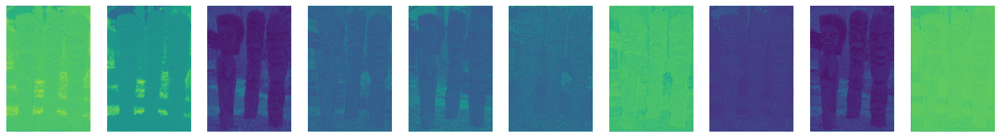

In [58]:
show_imgs([best_dual[0][i] for i in range(10)], two_d=True, figsize=(20, 10))

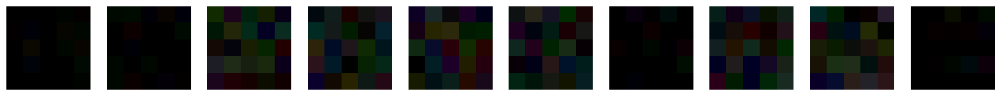

In [59]:
show_imgs([net.parameter[i].detach().cpu().numpy() for i in range(10)], figsize=(20, 20))

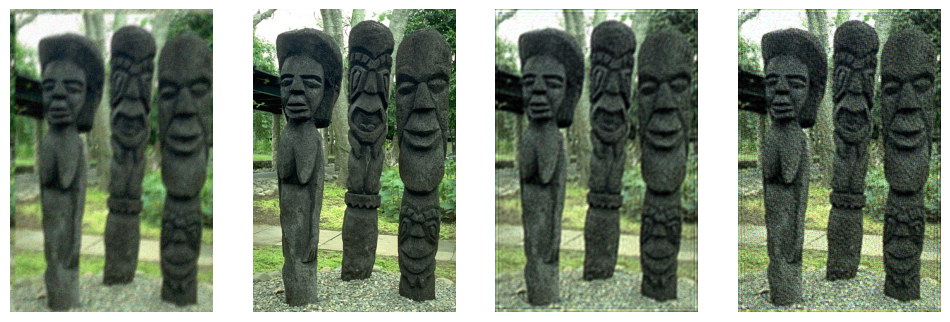

In [102]:
show_imgs([x_observed, x_truth, best_x, x_n], figsize=(12, 4))

### Synthesis more values of $L$

In [10]:
denoiser_names = [den for den in DENOISERS.keys() if den.split("_")[:-1] == ["SD", "10C", "1L"]]


Running denoiser: SD_10C_1L_1R


  0%|          | 0/1000 [00:00<?, ?it/s]

100%|██████████| 1000/1000 [01:18<00:00, 12.82it/s]


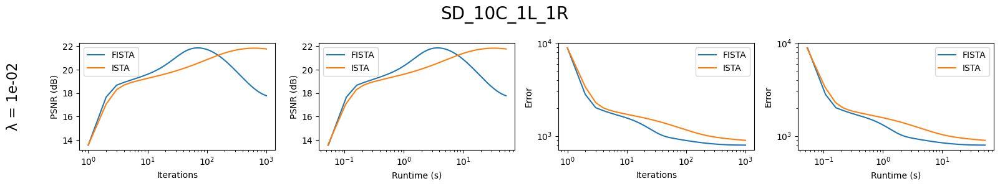


Running denoiser: SD_10C_1L_2R


100%|██████████| 1000/1000 [01:18<00:00, 12.79it/s]


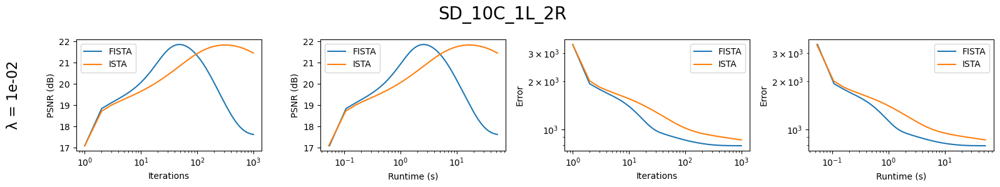


Running denoiser: SD_10C_1L_3R


100%|██████████| 1000/1000 [01:18<00:00, 12.75it/s]


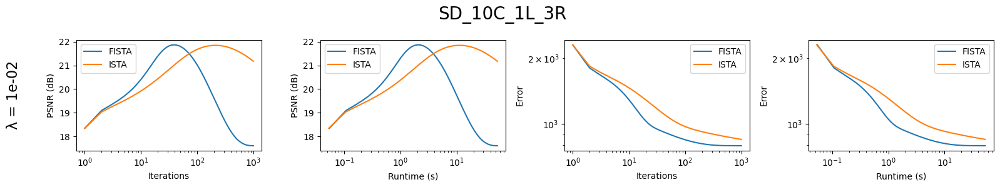


Running denoiser: SD_10C_1L_4R


100%|██████████| 1000/1000 [01:19<00:00, 12.64it/s]


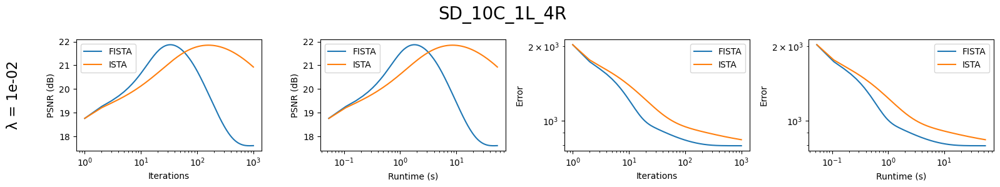


Running denoiser: SD_10C_1L_5R


100%|██████████| 1000/1000 [01:19<00:00, 12.59it/s]


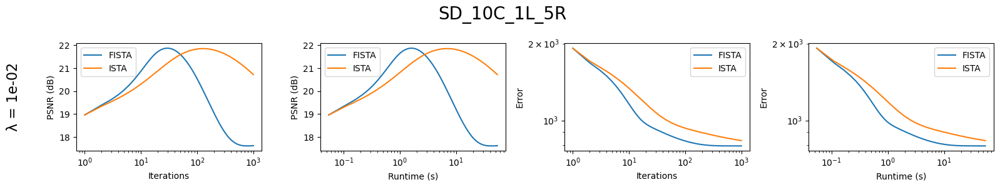


Running denoiser: SD_10C_1L_10R


100%|██████████| 1000/1000 [01:21<00:00, 12.20it/s]


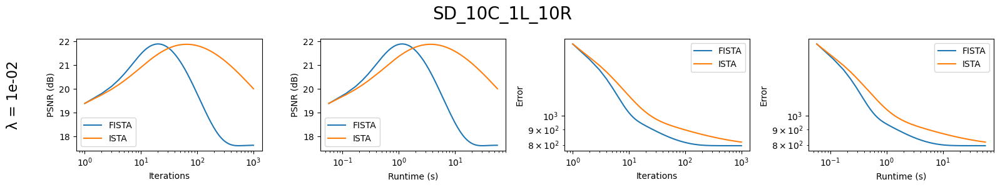


Running denoiser: SD_10C_1L_20R


100%|██████████| 1000/1000 [01:26<00:00, 11.59it/s]


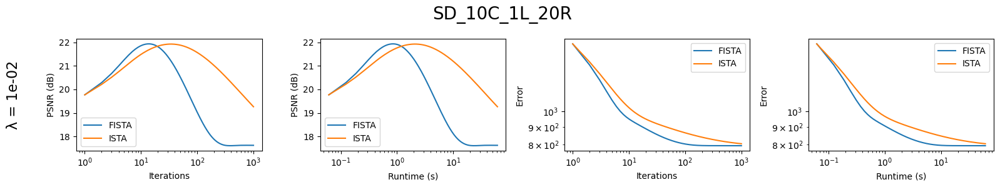


Running denoiser: SD_10C_1L_100R


100%|██████████| 1000/1000 [02:04<00:00,  8.04it/s]


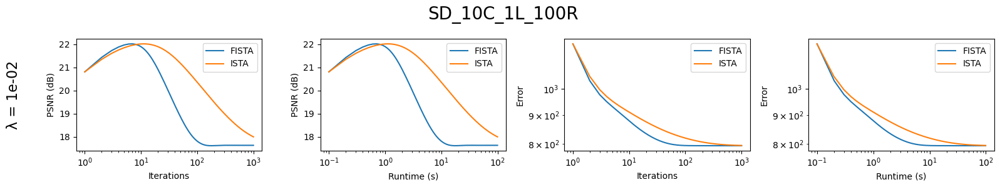


Running denoiser: SD_10C_1L_1000R


100%|██████████| 1000/1000 [09:09<00:00,  1.82it/s]


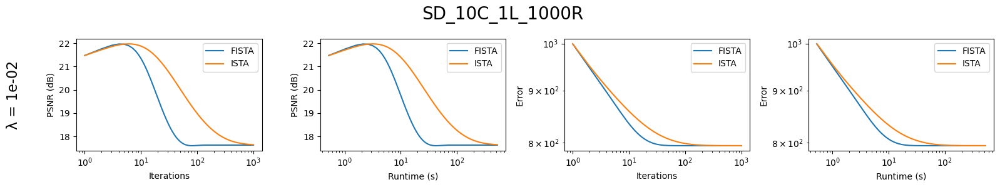

In [15]:
for denoiser_name in denoiser_names:
    
    print(f"\nRunning denoiser: {denoiser_name}")

    denoiser = DENOISERS[denoiser_name]
    net = denoiser["net"]
    model = "unrolled"
    
    lambdas = [1e-2] #, 1e-3, 1e-4]
    n = len(lambdas)
    plt.figure(figsize=(16, 3*n))
    i = 0
    
    for best_lambda in lambdas:
        
        x_n = Phi_channels(x_observed, Phit)
        current_dual = None
        current_dual_fast = None

        iter_final = 1000
        error_final = [0] * iter_final
        psnr_final = [0] * iter_final
        best_psnr = 0
        runtime_final = [0] * iter_final
        cvg_final = [0] * iter_final
        t_iter = 0
        update_dual = True

        for t in tqdm(range(iter_final)):
            
            t_start = time.perf_counter()

            g_n = Phi_channels((Phi_channels(x_n, Phi) - x_observed), Phit)
            tmp = x_n - gamma * g_n
            
            
            x_old = x_n.copy()
            alpha = t/(t+4)
            #alpha = 0
            x_n, current_dual, current_dual_fast = apply_model(
                model, tmp, current_dual, best_lambda, net, update_dual,
                fast=True, dual_fast=current_dual_fast, alpha_fast=alpha
            )

            t_iter += time.perf_counter() - t_start
            runtime_final[t] = t_iter
            cvg_final[t] = np.sum((x_n - x_old) ** 2)
            psnr_final[t] = peak_signal_noise_ratio(x_n, x_truth)
            error_final[t] = error_synthesis(current_dual[0], x_observed, net, Phi, best_lambda)
            
            if psnr_final[t] > best_psnr:
                best_x = x_n.copy()
                best_dual = current_dual.copy()
                best_psnr = psnr_final[t]

        x_n = Phi_channels(x_observed, Phit)
        current_dual = None
        current_dual_fast = None

        error_final_ista = [0] * iter_final
        psnr_final_ista = [0] * iter_final
        best_psnr_ista = 0
        runtime_final_ista = [0] * iter_final
        cvg_final_ista = [0] * iter_final
        t_iter = 0
        update_dual = True

        for t in tqdm(range(iter_final)):
            
            t_start = time.perf_counter()

            g_n = Phi_channels((Phi_channels(x_n, Phi) - x_observed), Phit)
            tmp = x_n - gamma * g_n
            
            
            x_old = x_n.copy()
            #alpha = t/(t+4)
            alpha = 0
            x_n, current_dual, current_dual_fast = apply_model(
                model, tmp, current_dual, best_lambda, net, update_dual,
                fast=True, dual_fast=current_dual_fast, alpha_fast=alpha
            )

            t_iter += time.perf_counter() - t_start
            runtime_final_ista[t] = t_iter
            cvg_final_ista[t] = np.sum((x_n - x_old) ** 2)
            psnr_final_ista[t] = peak_signal_noise_ratio(x_n, x_truth)
            error_final_ista[t] = error_synthesis(current_dual[0], x_observed, net, Phi, best_lambda)
            
            if psnr_final_ista[t] > best_psnr_ista:
                best_x_ista = x_n.copy()
                best_dual = current_dual.copy()
                best_psnr_ista = psnr_final_ista[t]

        
        
        plt.subplot(n, 4, 4*i+1)
        
        plt.text(-0.3, 0.5, f"λ = {best_lambda:.0e}", fontsize=16,
                 transform=plt.gca().transAxes, rotation=90,
                 verticalalignment='center', horizontalalignment='right')
        
        plt.semilogx(np.arange(1, iter_final + 1), psnr_final, label="FISTA")
        plt.semilogx(np.arange(1, iter_final + 1), psnr_final_ista, label="ISTA")
        plt.xlabel("Iterations")
        plt.ylabel("PSNR (dB)")
        plt.legend()

        plt.subplot(n, 4, 4*i+2)
        plt.semilogx(runtime_final, psnr_final, label="FISTA")
        plt.semilogx(runtime_final_ista, psnr_final_ista, label="ISTA")
        plt.xlabel("Runtime (s)")
        plt.ylabel("PSNR (dB)")
        plt.legend()

        plt.subplot(n, 4, 4*i+3)
        plt.loglog(np.arange(1, iter_final + 1), error_final, label="FISTA")
        plt.loglog(np.arange(1, iter_final + 1), error_final_ista, label="ISTA")
        plt.xlabel("Iterations")
        plt.ylabel("Error")
        plt.legend()

        plt.subplot(n, 4, 4*i+4)
        plt.loglog(runtime_final, error_final, label="FISTA")
        plt.loglog(runtime_final_ista, error_final_ista, label="ISTA")
        plt.xlabel("Runtime (s)")
        plt.ylabel("Error")
        plt.legend()
        
        i += 1

    plt.suptitle(f"{denoiser_name}", fontsize=20)
    plt.tight_layout()
    plt.show()

## DRUNet

In [11]:
eps_stop = None
denoiser_name = "DRUNet"

denoiser = DENOISERS[denoiser_name]
net = denoiser["net"]
model = "drunet"
model_type = denoiser["model"]

  0%|          | 0/50 [00:00<?, ?it/s]

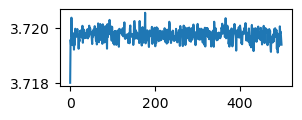

  2%|▏         | 1/50 [00:44<36:12, 44.34s/it]

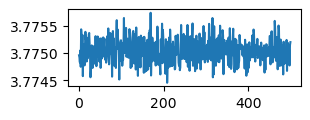

  4%|▍         | 2/50 [01:28<35:26, 44.30s/it]

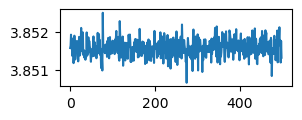

  6%|▌         | 3/50 [02:12<34:42, 44.30s/it]

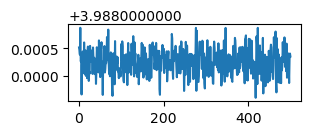

  8%|▊         | 4/50 [02:57<34:03, 44.43s/it]

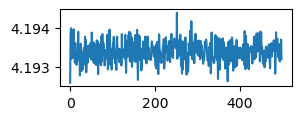

 10%|█         | 5/50 [03:42<33:21, 44.48s/it]

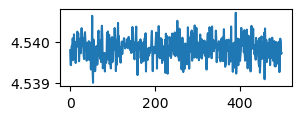

 12%|█▏        | 6/50 [04:26<32:36, 44.46s/it]

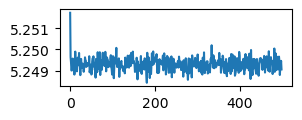

 14%|█▍        | 7/50 [05:10<31:48, 44.38s/it]

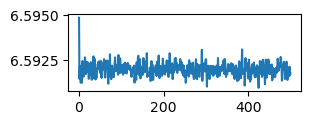

 16%|█▌        | 8/50 [05:54<31:01, 44.32s/it]

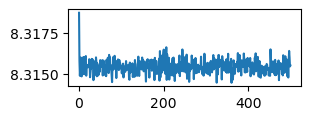

 18%|█▊        | 9/50 [06:39<30:15, 44.28s/it]

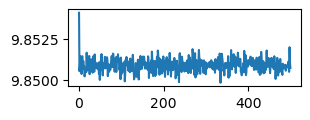

 20%|██        | 10/50 [07:23<29:30, 44.27s/it]

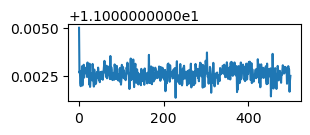

 22%|██▏       | 11/50 [08:07<28:46, 44.26s/it]

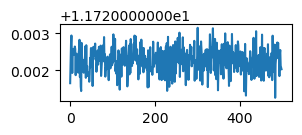

 24%|██▍       | 12/50 [08:51<28:01, 44.25s/it]

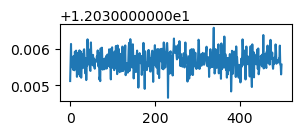

 26%|██▌       | 13/50 [09:36<27:17, 44.24s/it]

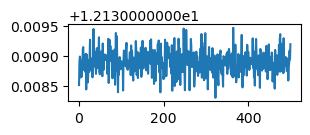

 28%|██▊       | 14/50 [10:20<26:32, 44.24s/it]

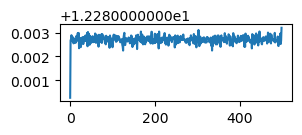

 30%|███       | 15/50 [11:04<25:48, 44.25s/it]

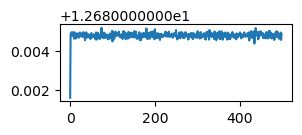

 32%|███▏      | 16/50 [11:48<25:04, 44.25s/it]

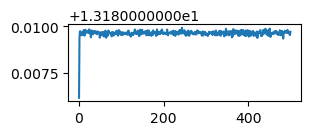

 34%|███▍      | 17/50 [12:33<24:19, 44.24s/it]

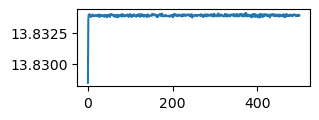

 36%|███▌      | 18/50 [13:17<23:35, 44.23s/it]

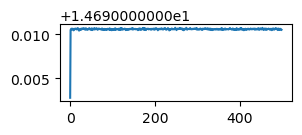

 38%|███▊      | 19/50 [14:01<22:50, 44.22s/it]

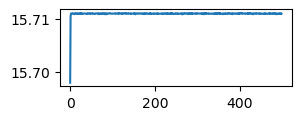

 40%|████      | 20/50 [14:45<22:06, 44.21s/it]

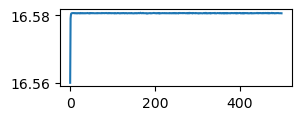

 42%|████▏     | 21/50 [15:29<21:21, 44.20s/it]

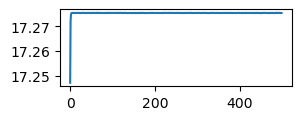

 44%|████▍     | 22/50 [16:14<20:37, 44.20s/it]

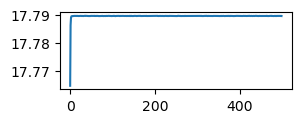

 46%|████▌     | 23/50 [16:58<19:53, 44.19s/it]

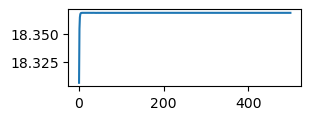

 48%|████▊     | 24/50 [17:42<19:09, 44.20s/it]

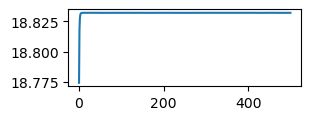

 50%|█████     | 25/50 [18:26<18:24, 44.19s/it]

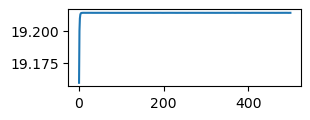

 52%|█████▏    | 26/50 [19:10<17:40, 44.19s/it]

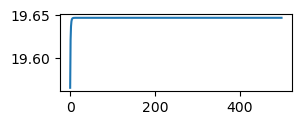

 54%|█████▍    | 27/50 [19:54<16:56, 44.20s/it]

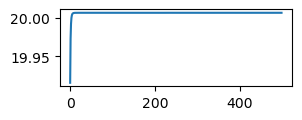

 56%|█████▌    | 28/50 [20:39<16:12, 44.21s/it]

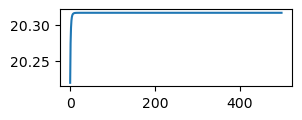

 58%|█████▊    | 29/50 [21:23<15:28, 44.21s/it]

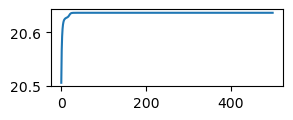

 60%|██████    | 30/50 [22:07<14:43, 44.19s/it]

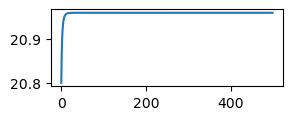

 62%|██████▏   | 31/50 [22:51<13:59, 44.18s/it]

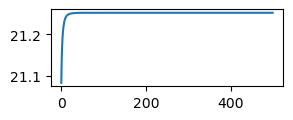

 64%|██████▍   | 32/50 [23:35<13:15, 44.18s/it]

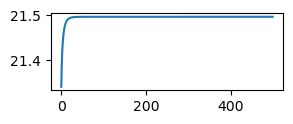

 66%|██████▌   | 33/50 [24:20<12:31, 44.18s/it]

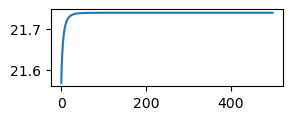

 68%|██████▊   | 34/50 [25:04<11:47, 44.19s/it]

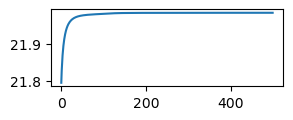

 70%|███████   | 35/50 [25:48<11:02, 44.19s/it]

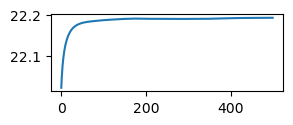

 72%|███████▏  | 36/50 [26:32<10:18, 44.21s/it]

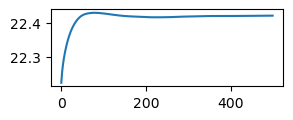

 74%|███████▍  | 37/50 [27:16<09:34, 44.21s/it]

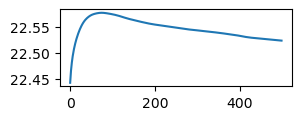

 76%|███████▌  | 38/50 [28:01<08:50, 44.20s/it]

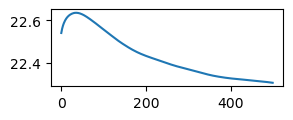

 78%|███████▊  | 39/50 [28:45<08:06, 44.20s/it]

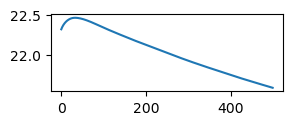

 80%|████████  | 40/50 [29:29<07:22, 44.25s/it]

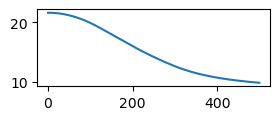

 82%|████████▏ | 41/50 [30:14<06:38, 44.30s/it]

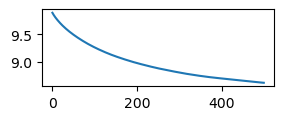

 84%|████████▍ | 42/50 [30:58<05:54, 44.31s/it]

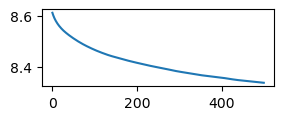

 86%|████████▌ | 43/50 [31:42<05:10, 44.32s/it]

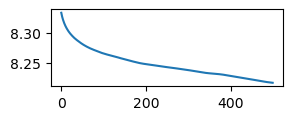

 88%|████████▊ | 44/50 [32:27<04:25, 44.33s/it]

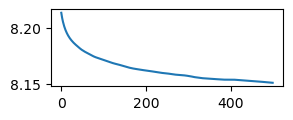

 90%|█████████ | 45/50 [33:11<03:41, 44.34s/it]

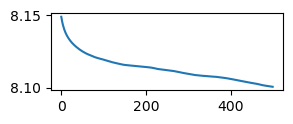

 92%|█████████▏| 46/50 [33:55<02:57, 44.35s/it]

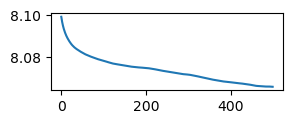

 94%|█████████▍| 47/50 [34:40<02:13, 44.36s/it]

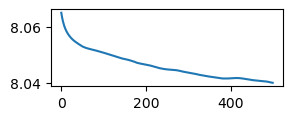

 96%|█████████▌| 48/50 [35:24<01:28, 44.38s/it]

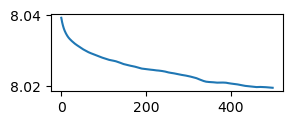

 98%|█████████▊| 49/50 [36:09<00:44, 44.38s/it]

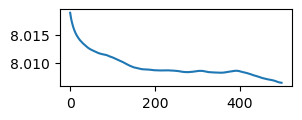

100%|██████████| 50/50 [36:53<00:00, 44.27s/it]


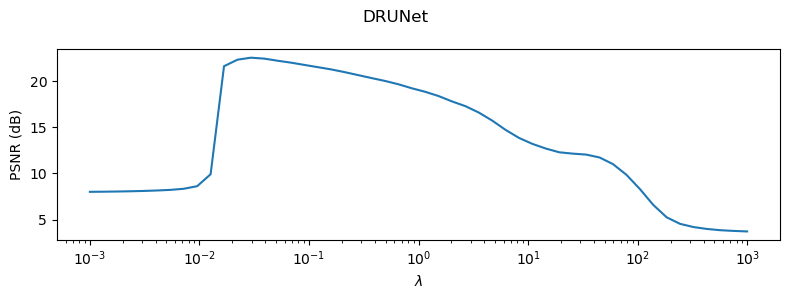

In [20]:
n_lambda = 50
lambda_list = np.logspace(np.log10(1e3), np.log10(1e-3), n_lambda)
n_iter_per_lambda = 500

n_lambda = len(lambda_list)
if lambda_list is None:
    lambda_list = [0.5 * std_noise] * n_lambda

x_n = Phi_channels(x_observed, Phit)
best_x_psnr = x_n.copy()
best_x_error = x_n.copy()
best_psnr = 0
best_error = 0
best_lambda = 0

cvg = [1e10] * n_lambda*n_iter_per_lambda
psnr = [0] * n_lambda
error = [0] * n_lambda
psnr_inner = [0] * n_lambda*n_iter_per_lambda
error_inner = [0] * n_lambda*n_iter_per_lambda
runtime = [0] * n_lambda*n_iter_per_lambda
stops = [0] * (n_lambda+1)

current_dual = None
current_dual_fast = None

best_current_dual, best_current_dual_fast = None, None

t_iter = 0

i = 0
for k in tqdm(range(n_lambda)):
    if not warm_restart:
        x_n = Phi_channels(x_observed, Phit)
        current_dual = None
        current_dual_fast = None
    
    for t in range(n_iter_per_lambda):
        t_start = time.perf_counter()
        g_n = Phi_channels((Phi_channels(x_n, Phi) - x_observed), Phit)
        tmp = x_n - gamma * g_n
        x_old = x_n.copy()

        x_n, current_dual = apply_model(
            model, tmp, current_dual, lambda_list[k], net, True
        )
        
        t_iter += time.perf_counter() - t_start
        cvg[i] = np.sum((x_n - x_old) ** 2)
        runtime[i] = t_iter
        psnr_inner[i] = peak_signal_noise_ratio(x_n, x_truth)
        criterion = np.sum((x_n - x_old) ** 2 / np.sum(x_old ** 2))
            
        if eps_stop is not None and criterion < eps_stop:
            break
        i += 1
    
    stops[k+1] = i
    
    if x_truth is not None:
        psnr[k] = psnr_inner[i-1]
        error[k] = error_inner[i-1]
        if psnr[k] > best_psnr:
            best_psnr = psnr[k]
            best_x_psnr = x_n.copy()
            best_lambda = lambda_list[k]
            bestb_current_dual = current_dual.copy() if current_dual is not None else None
            best_current_dual_fast = current_dual_fast.copy() if current_dual_fast is not None else None
        if error[k] < best_error:
            best_error = error[k]
            best_x_error = x_n.copy()
    
    plt.figure(figsize=(3, 1))
    plt.plot(psnr_inner[stops[k]:stops[k+1]])
    plt.show()

# Plot PSNR vs lambda and error vs lambda on 2 subplots
plt.figure(figsize=(8, 3))
plt.semilogx(lambda_list, psnr)
plt.xlabel(r"$\lambda$")
plt.ylabel("PSNR (dB)")
plt.suptitle(f"{denoiser_name}")
plt.tight_layout()
plt.show()

In [21]:
import os
if not os.path.exists("convergence/DRUNet"):
    os.makedirs("convergence/DRUNet")

with open(f"convergence/DRUNet/results_optimal_lambda.pkl", "wb") as f:
    pickle.dump({
        "lambda_list": lambda_list,
        "psnr": psnr,
        "error": error,
        "psnr_inner": psnr_inner,
        "error_inner": error_inner,
        "runtime": runtime,
        "stops": stops,
        "best_x_psnr": best_x_psnr,
        "best_x_error": best_x_error,
        "best_lambda": best_lambda,
        "best_current_dual": best_current_dual,
        "best_current_dual_fast": best_current_dual_fast
    }, f)

/tmp/ipykernel_1181300/2778812298.py:22: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  isnr = peak_signal_noise_ratio(x_truth, x_observed)


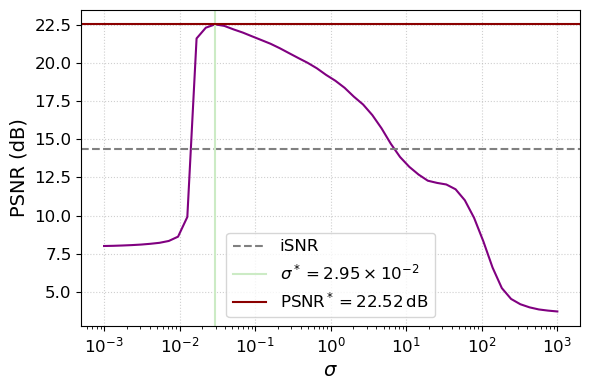

In [12]:
# Load .pkl file
with open(f"convergence/DRUNet/results_optimal_lambda.pkl", "rb") as f:
    results = pickle.load(f)
lambda_list = results["lambda_list"]
psnr = results["psnr"]
error = results["error"]
psnr_inner = results["psnr_inner"]
error_inner = results["error_inner"]
runtime = results["runtime"]
stops = results["stops"]
best_x_psnr = results["best_x_psnr"]
best_x_error = results["best_x_error"]
best_lambda = results["best_lambda"]
best_current_dual = results["best_current_dual"]
best_current_dual_fast = results["best_current_dual_fast"]


significand = best_lambda / (10 ** np.floor(np.log10(best_lambda)))
exponent = int(np.floor(np.log10(best_lambda)))

colors = plt.get_cmap("Pastel1").colors
isnr = peak_signal_noise_ratio(x_truth, x_observed)

plt.figure(figsize=(6, 4))
plt.semilogx(lambda_list, psnr, color="purple")
plt.axhline(isnr, color='grey', linestyle='--', label='iSNR')
plt.axvline(
    best_lambda, color=colors[2], linewidth=1.5,
    label=rf"$\sigma^* = {significand:.2f} \times 10^{{{exponent}}}$"
)
plt.axhline(
    22.52, color="darkred", linewidth=1.5,
    label=rf"$\mathrm{{PSNR}}^* = {22.52:.2f}\,\mathrm{{dB}}$"
)

plt.xlabel(r"$\sigma$", fontsize=14)
plt.ylabel("PSNR (dB)", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.legend(fontsize=12)
plt.grid(True, linestyle=':', alpha=0.6)

plt.tight_layout()
#plt.savefig("convergence/DRUNet/psnr_vs_lambda.pdf", bbox_inches='tight')

  0%|          | 0/500 [00:00<?, ?it/s]

100%|██████████| 500/500 [00:44<00:00, 11.21it/s]


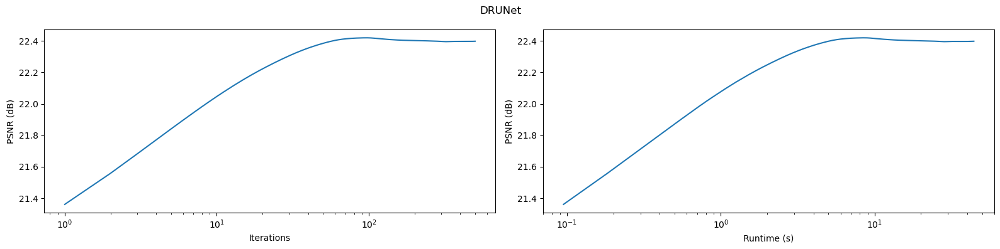

In [31]:
best_lambda=4e-2

x_n = Phi_channels(x_observed, Phit)
current_dual = None
current_dual_fast = None

iter_final = 500
error_final = [0] * iter_final
psnr_final = [0] * iter_final
best_psnr = 0
runtime_final = [0] * iter_final
cvg_final = [0] * iter_final
t_iter = 0
update_dual = True

for t in tqdm(range(iter_final)):
    
    t_start = time.perf_counter()

    g_n = Phi_channels((Phi_channels(x_n, Phi) - x_observed), Phit)
    tmp = x_n - gamma * g_n
    
    x_old = x_n.copy()
    x_n, current_dual = apply_model(
            model, tmp, current_dual, best_lambda, net, update_dual
        )

    t_iter += time.perf_counter() - t_start
    runtime_final[t] = t_iter
    cvg_final[t] = np.sum((x_n - x_old) ** 2)
    psnr_final[t] = peak_signal_noise_ratio(x_n, x_truth)
    
    if psnr_final[t] > best_psnr:
        best_x = x_n.copy()
        best_psnr = psnr_final[t]

plt.figure(figsize=(16, 4))

plt.subplot(1, 2, 1)
plt.semilogx(np.arange(1, iter_final + 1), psnr_final)
plt.xlabel("Iterations")
plt.ylabel("PSNR (dB)")

plt.subplot(1, 2, 2)
plt.semilogx(runtime_final, psnr_final)
plt.xlabel("Runtime (s)")
plt.ylabel("PSNR (dB)")

plt.suptitle(f"{denoiser_name}")
plt.tight_layout()
plt.show()

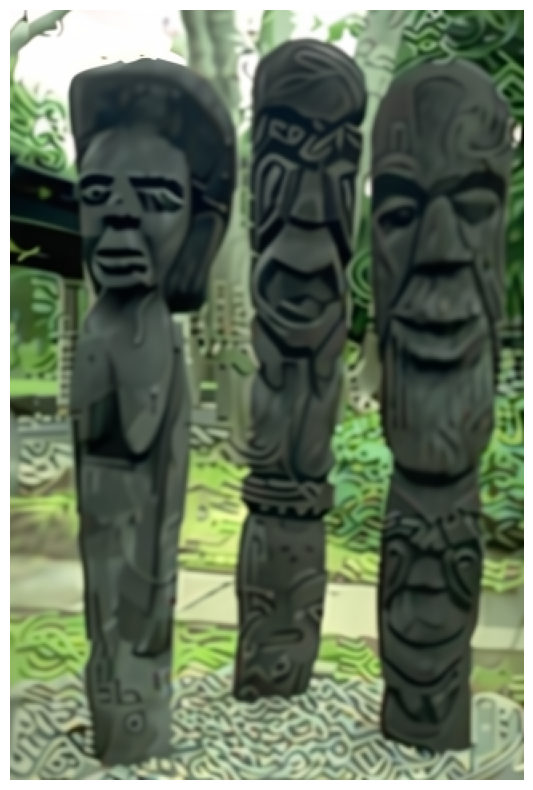

In [15]:
# Show and save x_n
plt.figure(figsize=(10,10))
plt.imshow(best_x_psnr.transpose(1, 2, 0))
plt.axis('off')
plt.savefig(f"images_deblurring/drunet.png", bbox_inches='tight')
plt.show()

100%|██████████| 5/5 [07:20<00:00, 88.19s/it]


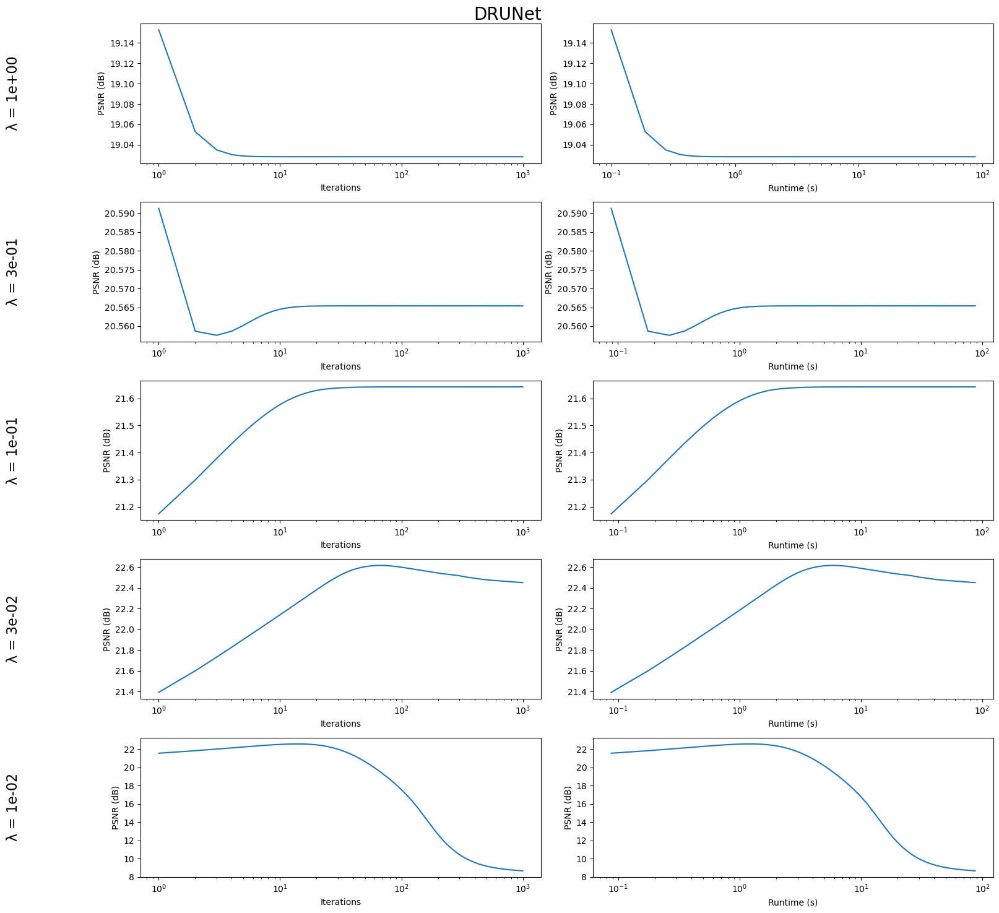

In [165]:
denoiser = DENOISERS[denoiser_name]
net = denoiser["net"]
model = "drunet"

lambdas = [1, 3e-1, 1e-1, 3e-2, 1e-2]
n = len(lambdas)
plt.figure(figsize=(16, 3*n))
i = 0

for best_lambda in tqdm(lambdas):
    
    x_n = Phi_channels(x_observed, Phit)
    current_dual = None
    current_dual_fast = None

    iter_final = 1000
    error_final = [0] * iter_final
    psnr_final = [0] * iter_final
    best_psnr = 0
    runtime_final = [0] * iter_final
    cvg_final = [0] * iter_final
    t_iter = 0
    update_dual = True

    for t in range(iter_final):
        
        t_start = time.perf_counter()

        g_n = Phi_channels((Phi_channels(x_n, Phi) - x_observed), Phit)
        tmp = x_n - gamma * g_n
        
        
        x_old = x_n.copy()
        x_n, current_dual = apply_model(
                model, tmp, current_dual, best_lambda, net, update_dual
            )

        t_iter += time.perf_counter() - t_start
        runtime_final[t] = t_iter
        cvg_final[t] = np.sum((x_n - x_old) ** 2)
        psnr_final[t] = peak_signal_noise_ratio(x_n, x_truth)
        
        if psnr_final[t] > best_psnr:
            best_x = x_n.copy()
            best_psnr = psnr_final[t]

    x_n = Phi_channels(x_observed, Phit)
    current_dual = None
    current_dual_fast = None

    error_final_ista = [0] * iter_final
    psnr_final_ista = [0] * iter_final
    best_psnr_ista = 0
    runtime_final_ista = [0] * iter_final
    cvg_final_ista = [0] * iter_final
    t_iter = 0
    update_dual = True
    
    plt.subplot(n, 2, 2*i+1)
    
    plt.text(-0.3, 0.5, f"λ = {best_lambda:.0e}", fontsize=16,
                transform=plt.gca().transAxes, rotation=90,
                verticalalignment='center', horizontalalignment='right')
    
    plt.semilogx(np.arange(1, iter_final + 1), psnr_final)
    plt.xlabel("Iterations")
    plt.ylabel("PSNR (dB)")

    plt.subplot(n, 2, 2*i+2)
    plt.semilogx(runtime_final, psnr_final)
    plt.xlabel("Runtime (s)")
    plt.ylabel("PSNR (dB)")
    i += 1

plt.suptitle(f"{denoiser_name}", fontsize=20)
plt.tight_layout()
plt.show()

# FILTERS 16x16

In [21]:
std_noise_train = 0.05
std_noise = 0.0
components_list = [10, 50] #[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 20, 50, 100]
layers_list = [1, 20] #[1, 20]
n_rep_list = [1, 2, 3, 4, 5, 10, 20, 100, 1000] #[1, 20, 50, 100]
denoiser_type_list = ["SD"] #, "SD"]
pth_kernel = "blur_models/blur_3.mat" #"blur_models/blur_1.mat"
img_list = [0] #, 4]
n_iter_per_lambda = 200
n_lambda = 50
lambda_start = 10
lambda_end = 1e-5
eps_stop = 1e-6
warm_restart = True
save_path = "experiments/gloubiboulga/results.pkl"

params_model = {
        "kernel_size": 16,
        "lmbd": 1e-4,
        "color": COLOR,
        "device": DEVICE,
        "dtype": torch.float,
        "optimizer": "adam",
        "path_data": DATA_PATH,
        "max_sigma_noise": std_noise_train,
        "min_sigma_noise": std_noise_train,
        "mini_batch_size": 1,
        "max_batch": 10,
        "epochs": 50,
        "avg": False,
        "rescale": False,
        "fixed_noise": True,
        "D_shared": True,
        "step_size_scaling": 1.8,
        "lr": 1e-3,
        "dataset": DATASET,
    }

In [22]:
T_START = time.time()

DENOISERS = {"DRUNet": dict(model="drunet")}
DENOISERS["DRUNet"]["net"] = get_denoiser(**DENOISERS["DRUNet"])

for denoiser_type in denoiser_type_list:
    for components in components_list:
        for layers in layers_list:
            params = {k: v for k, v in params_model.items()}
            params["n_layers"] = layers
            params["n_components"] = components
            
            # ----- #REPEAT = #LAYERS -----
            if denoiser_type == "SD":
                base_name = f"SD_{components}C_{layers}L"
                model_type = "synthesis"
            elif denoiser_type == "AD":
                base_name = f"AD_{components}C_{layers}L"
                model_type = "analysis"
            
            name = f"{base_name}_{layers}R"
            DENOISERS[name] = {"model": model_type, **params}
            print(f"Training {base_name}...")
            DENOISERS[name]["net"] = get_denoiser(**DENOISERS[name])
            
            # ----- #REPEAT = 1 -----
            if layers > 1:
                denoiser = DENOISERS[name]
                old_net = denoiser["net"]
                net = UnrolledCDL(
                    type_unrolling=denoiser["model"],
                    **{k: v for k, v in denoiser.items() if k not in ["model", "net"]}
                ).unrolled_net
                # Replace the model with only the first layer of the trained model
                net.parameter = old_net.parameter
                net.model = torch.nn.ModuleList([old_net.model[0]])
                DENOISERS[f"{base_name}_1R"] = dict(net=net, model=denoiser["model"], **params)
                DENOISERS[f"{base_name}_1R"]["n_layers"] = 1
            
            # ----- #REPEAT = N_REP -----
            for n_rep in n_rep_list:
                if n_rep == layers:
                    continue
                denoiser = DENOISERS[f"{base_name}_1R"]
                old_net = denoiser["net"]
                net = UnrolledCDL(
                    type_unrolling=denoiser["model"],
                    **{k: v for k, v in denoiser.items() if k not in ["model", "net"]}
                ).unrolled_net
                assert len(net.model) == 1
                net.parameter = old_net.parameter
                net.model = torch.nn.ModuleList([old_net.model[0]] * n_rep)
                DENOISERS[f"{base_name}_{n_rep}R"] = dict(
                    net=net, model=denoiser["model"], **params
                )
                DENOISERS[f"{base_name}_{n_rep}R"]["n_layers"] = n_rep

print(f"\nSuccessfully prepared {len(DENOISERS.keys())} denoisers in {time.time() - T_START:.2f} seconds.")

Training SD_10C_1L...


Epoch 50 - Average train loss: 0.09320021 - Average test loss: 0.08696721: 100%|██████████| 50/50 [00:03<00:00, 12.70it/s]


Done
Training SD_10C_20L...


Epoch 13 - Average train loss: 0.01185370 - Average test loss: 0.01114443:  26%|██▌       | 13/50 [00:07<00:20,  1.77it/s]


KeyboardInterrupt: 

In [ ]:
dataloader = create_dataloader(
    DATA_PATH,
    min_sigma_noise=std_noise,
    max_sigma_noise=std_noise,
    device=DEVICE,
    dtype=torch.float,
    mini_batch_size=1,
    train=False,
    color=COLOR,
    fixed_noise=True,
    crop=False,
)

In [5]:
img = dataloader.dataset[img_list[0]][1].cpu().numpy()
x_truth = img

h = scipy.io.loadmat(pth_kernel)
h = np.array(h["blur"])

Phi, Phit = get_operators(type_op="deconvolution", pth_kernel=pth_kernel)
x_blurred = Phi_channels(img, Phi)
nc, nxb, nyb = x_blurred.shape
x_observed = x_blurred + std_noise * np.random.randn(nc, nxb, nyb)
normPhi2 = op_norm2(Phi, Phit, x_observed.shape)
gamma = 1.0 / normPhi2

In [6]:
results = {
    "observation": x_observed,
    "truth": img
}

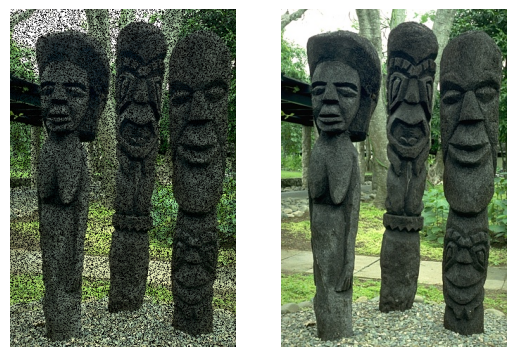

PSNR: 12.61 dB


In [20]:
def show_imgs(list_img, figsize=None, two_d=False):
    plt.figure(figsize=figsize)
    for i, img in enumerate(list_img):
        plt.subplot(1, len(list_img), i + 1)
        if two_d:
            img = img.squeeze()
        else:
            img = img.transpose(1, 2, 0)
        plt.imshow(img)
        plt.axis("off")
    plt.show()

show_imgs([x_observed.clip(0,1), x_truth])
print(f"PSNR: {peak_signal_noise_ratio(x_truth, x_observed.clip(0, 1)):.2f} dB")

In [15]:
denoiser_names = ["SD_10C_1L_100R"] #, "SD_10C_1L_100R"]


Running denoiser: SD_10C_1L_100R


100%|██████████| 1000/1000 [11:33<00:00,  1.44it/s]


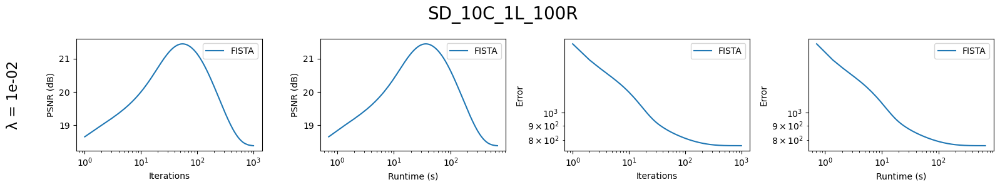

In [ ]:
for denoiser_name in denoiser_names:
    
    print(f"\nRunning denoiser: {denoiser_name}")

    denoiser = DENOISERS[denoiser_name]
    net = denoiser["net"]
    model = "unrolled"
    
    lambdas = [1e-2] #, 1e-3, 1e-4]
    n = len(lambdas)
    plt.figure(figsize=(16, 3*n))
    i = 0
    
    for best_lambda in lambdas:
        
        x_n = Phi_channels(x_observed, Phit)
        current_dual = None
        current_dual_fast = None

        iter_final = 1000
        error_final = [0] * iter_final
        psnr_final = [0] * iter_final
        best_psnr = 0
        runtime_final = [0] * iter_final
        cvg_final = [0] * iter_final
        t_iter = 0
        update_dual = True

        for t in tqdm(range(iter_final)):
            
            t_start = time.perf_counter()

            g_n = Phi_channels((Phi_channels(x_n, Phi) - x_observed), Phit)
            tmp = x_n - gamma * g_n
            
            
            x_old = x_n.copy()
            alpha = t/(t+4)
            #alpha = 0
            x_n, current_dual, current_dual_fast = apply_model(
                model, tmp, current_dual, best_lambda, net, update_dual,
                fast=True, dual_fast=current_dual_fast, alpha_fast=alpha
            )

            t_iter += time.perf_counter() - t_start
            runtime_final[t] = t_iter
            cvg_final[t] = np.sum((x_n - x_old) ** 2)
            psnr_final[t] = peak_signal_noise_ratio(x_n, x_truth)
            error_final[t] = error_synthesis(current_dual[0], x_observed, net, Phi, best_lambda)
            
            if psnr_final[t] > best_psnr:
                best_x = x_n.copy()
                best_dual = current_dual.copy()
                best_psnr = psnr_final[t]
        
        plt.subplot(n, 4, 4*i+1)
        
        plt.text(-0.3, 0.5, f"λ = {best_lambda:.0e}", fontsize=16,
                 transform=plt.gca().transAxes, rotation=90,
                 verticalalignment='center', horizontalalignment='right')
        
        plt.semilogx(np.arange(1, iter_final + 1), psnr_final, label="FISTA")
        plt.xlabel("Iterations")
        plt.ylabel("PSNR (dB)")
        plt.legend()

        plt.subplot(n, 4, 4*i+2)
        plt.semilogx(runtime_final, psnr_final, label="FISTA")
        plt.xlabel("Runtime (s)")
        plt.ylabel("PSNR (dB)")
        plt.legend()

        plt.subplot(n, 4, 4*i+3)
        plt.loglog(np.arange(1, iter_final + 1), error_final, label="FISTA")
        plt.xlabel("Iterations")
        plt.ylabel("Error")
        plt.legend()

        plt.subplot(n, 4, 4*i+4)
        plt.loglog(runtime_final, error_final, label="FISTA")
        plt.xlabel("Runtime (s)")
        plt.ylabel("Error")
        plt.legend()
        
        i += 1

    plt.suptitle(f"{denoiser_name}", fontsize=20)
    plt.tight_layout()
    plt.show()

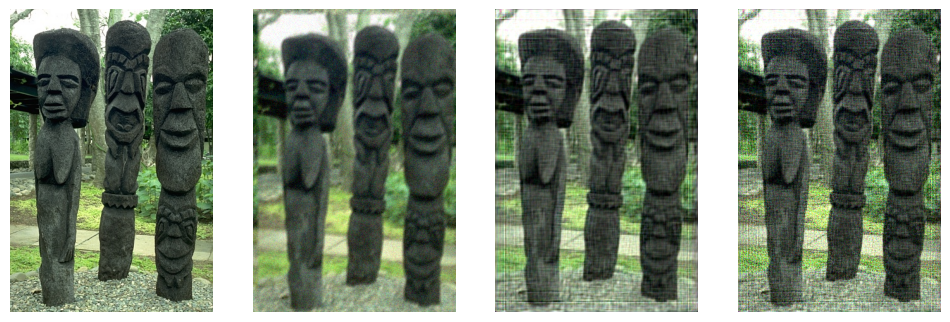

In [27]:
show_imgs([x_truth, x_observed, best_x, x_n], figsize=(12, 4))

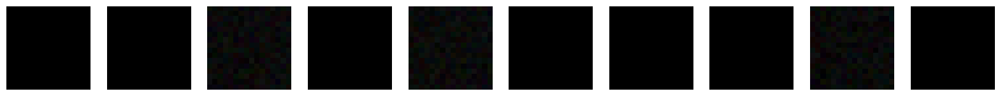

In [28]:
show_imgs([net.parameter[i].detach().cpu().numpy() for i in range(10)], figsize=(20, 20))